# Methods for Data Science: Course Work 1

In [1]:
import pandas as pd # import pandas library
import numpy as np # import numpy library
import matplotlib.pyplot as plt # import matplotlib library
from tqdm import tqdm # import tqdm library for loading bars
import seaborn as sns # import seaborn library
np.random.seed(1727546) # set np.random seed to CID number

In [2]:
sns.set(rc={'figure.figsize':(20,15)}) # set seaborn figure size
plt.rcParams['figure.dpi']= 300 # set matplotlib figure dpi
plt.rcParams['figure.figsize'] = 8, 6

## Task 1:  Regression (50 marks)



#### 1.1 Linear regression (8 marks)  

##### 1.1.1

We first start by loading the data and performing some elementary data analysis:

In [3]:
airfoil_noise_train = pd.read_csv("data/airfoil_noise_samples.csv") # read in airfoil noise training data
airfoil_columns = airfoil_noise_train.columns.to_numpy()[:-1] # get column names of airfoil noise training data
airfoil_noise_train.head() # display first 5 rows of airfoil noise training data

,Frequency,Angle,Displacement,Chord length,Velocity,Thickness,Sound Pressure
0,2175.611424,15.138865,21.075119,0.088194,66.764401,0.044771,122.365215
1,2962.923620,13.400893,13.200889,0.048462,78.221903,0.011041,129.296236
2,4430.810843,2.164599,13.959536,0.226743,57.053201,0.011499,121.827380
3,4939.695645,13.857682,18.203793,0.021705,23.896377,0.021475,114.998132
4,2193.979785,9.298757,11.007713,0.052737,38.917034,0.001741,125.639641


We also load the test data for later use.

In [4]:
airfoil_noise_test = pd.read_csv("data/airfoil_noise_test.csv") # read in airfoil noise test data
airfoil_noise_test.head() # display first 5 rows of airfoil noise test data

,Frequency,Angle,Displacement,Chord length,Velocity,Thickness,Sound Pressure
0,1143.654418,12.783087,15.277127,0.110389,46.089548,0.024076,125.332111
1,619.208992,4.460285,16.198696,0.284357,36.728360,0.004000,122.801183
2,646.114737,2.521952,7.533605,0.072292,59.498237,0.003590,129.361188
3,1246.777461,8.438129,12.396435,0.034411,47.557277,0.002407,125.656263
4,286.200927,12.238350,20.877161,0.082437,72.786590,0.036883,124.241736


In [5]:
airfoil_noise_test.describe() # display summary statistics of airfoil noise test data

,Frequency,Angle,Displacement,Chord length,Velocity,Thickness,Sound Pressure
count,973.000000,973.000000,973.000000,973.000000,973.000000,973.000000,973.000000
mean,2899.010272,8.168879,13.457254,0.137074,50.775639,0.014163,123.968845
std,2678.943633,5.606230,4.551486,0.093508,15.940928,0.014034,4.654713
min,25.769177,0.011299,0.082166,0.000848,21.139451,0.000002,107.996004
25%,1076.460339,3.618578,10.562385,0.054891,36.987297,0.004148,121.106574
50%,2005.178515,7.249896,13.971662,0.122195,47.345385,0.008715,124.126098
75%,3842.996299,11.799025,16.506753,0.208549,66.755918,0.019872,127.207364
max,19744.221140,26.623922,26.393545,0.360646,84.766450,0.068163,136.422496


Lastly in our EDA, we produce a pairplot of the features:

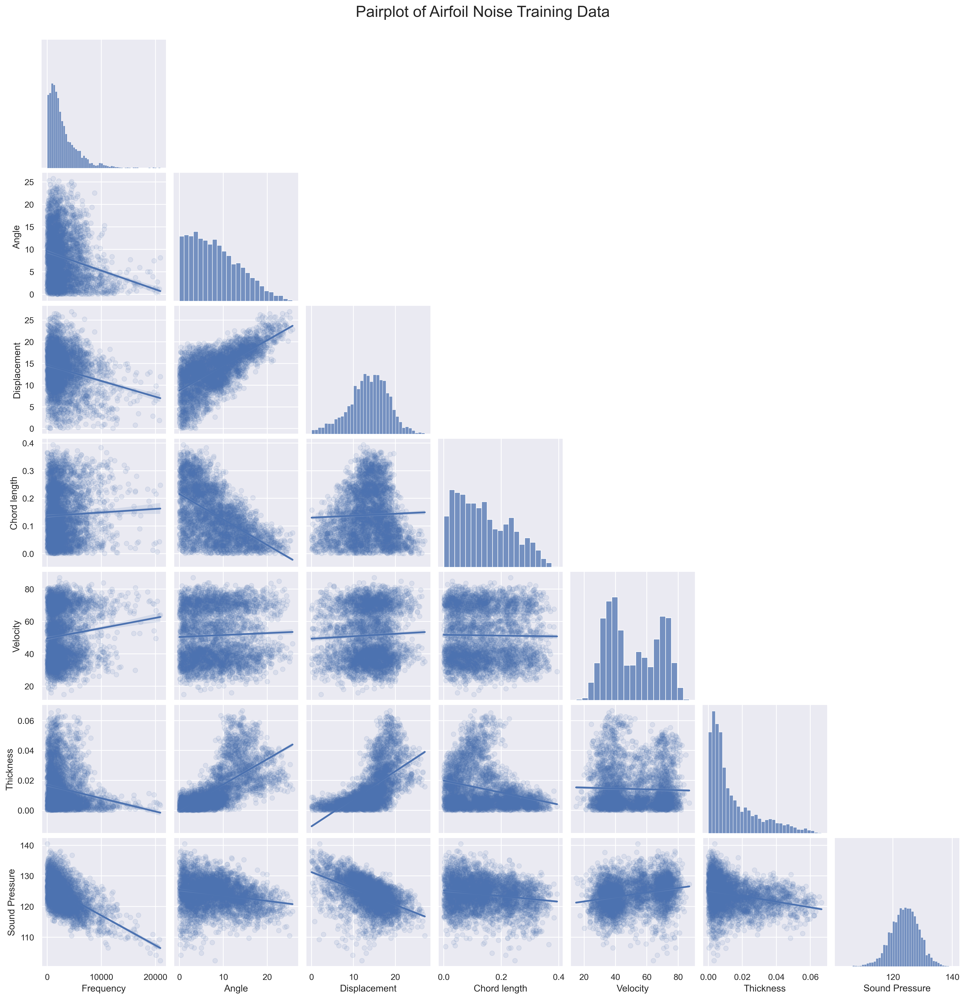

In [116]:
sns.pairplot(airfoil_noise_train, kind='reg', corner=True,  plot_kws = {'scatter_kws': {'alpha': 0.1}}) # plot pairplot of airfoil noise training data
plt.suptitle("Pairplot of Airfoil Noise Training Data", y=1.02, fontsize=20) # set title of pairplot
plt.show()

Throughout, let $\mathbf{x}_i\in\mathbb{R}^D$ for $i=1,\dots, N$ be the predictor data column vectors, i.e. the vectors containing all of the data for a given observation except the Sound Pressure. Moreover, let $\beta_i$ for $i=1,\dots,6$ be the $i$ th predictor variable, where the predictor variables are in the same order they appear in the columns, and let $\beta_7$ be the Sound Pressure. 

We now split the data into our predictor matrix $\mathbf{X}\in\mathbb{R}^{N\times D}$, defined as:

$$
\mathbf{X} = \begin{pmatrix}
\mathbf{x}_1^\top\\
\mathbf{x}_2^\top\\
\vdots\\
\mathbf{x}_N^\top
\end{pmatrix}
$$
 and predicted variable $\mathbf{y}$. In this case, $\mathbf{(y)}_i$ is the observed sound pressure for the $i$ th observation.

We split our train and test data into the predictor variable matrix, $\mathbf{X}$, and our predicted variable, $\mathbf{y}$.

The first step is to standardise our predictor variable matrix $\mathbf{X}$; this is necessary to be able to compare the parameters we are optimising to each other, and to reduce $\mathbf{X}$'s condition number, as in its unstandardised state it is $\approx 400,000$, which is very high and will make gradient descent difficult.

In [9]:
# drop target column and convert to numpy array
X_train_unstd = airfoil_noise_train.drop("Sound Pressure", axis=1).to_numpy() 
# convert to numpy array
y_train = airfoil_noise_train["Sound Pressure"].to_numpy()
# drop target column and convert to numpy array
X_test_unstd = airfoil_noise_test.drop("Sound Pressure", axis=1).to_numpy()
# convert to numpy array
y_test = airfoil_noise_test["Sound Pressure"].to_numpy()

# print condition number of unstandardised matrix X
print(f"Condition number of unstandardised matrix X: {round(np.linalg.cond(X_train_unstd))}") 

Condition number of unstandardised matrix X: 411342


We now proceed to standardise our predictor variable matrix, and we change the dimensions of our predicted variable vector $\mathbf{y}$ so `numpy` interprets it as a column vector as opposed to a row vector. Additionally, we shuffle our data to exclude any possible ordering the data may be in:

In [10]:
X_train = (X_train_unstd - np.mean(X_train_unstd, axis=0))/np.std(X_train_unstd, axis=0) # standardise X_train
X_test = (X_test_unstd - np.mean(X_train_unstd, axis=0))/np.std(X_train_unstd, axis=0) # standardise X_test

N,D = np.shape(X_train) # get number of samples and number of features

y_train = y_train.reshape(N,1) # reshape y_train to be a column vector
y_test = y_test.reshape(np.shape(X_test)[0],1) # reshape y_test to be a column vector

# shuffle training data
train_indices = np.arange(N) # create array of indices
np.random.shuffle(train_indices) # shuffle indices
X_train = X_train[train_indices] # shuffle X_train
y_train = y_train[train_indices] # shuffle y_train

# shuffle test data
test_indices = np.arange(np.shape(X_test)[0]) # create array of indices
np.random.shuffle(test_indices) # shuffle indices
X_test = X_test[test_indices] # shuffle X_test
y_test = y_test[test_indices] # shuffle y_test

We display the condition number of the standardised $\mathbf{X}$ matrix to see how it changes after standardising:

In [11]:
print(f"Condition number of standardised matrix X: {round(np.linalg.cond(X_train))}") # print condition number of standardised matrix X

Condition number of standardised matrix X: 5


We can see it has drastically reduced to $5$, making gradient descent converge faster and thus usable.

We now turn our attention to the loss function:

$$
L(\beta) = \frac{1}{2N}\|\mathbf{y} - \mathbf{X}\beta-\mathbf{\beta_0}\|^2
$$

Where $\beta\in\mathbb{R}^D,\mathbf{\beta_0}\in\mathbb{R}^N$. Note that $\mathbf{\beta_0} = \beta_0 \mathbf{z}_N$, where $\mathbf{z}_N := \begin{pmatrix}1\\1\\\vdots\\1\end{pmatrix}\in\mathbb{R}^N$

Consider one coordinate of $\mathbf{y},\, y_i$. Then we wish to minimise:
$$
y_i = \mathbf{x}_i^\top\beta + \beta_0 = \begin{pmatrix}1 & \mathbf{x_i}^\top\end{pmatrix} \begin{pmatrix}\beta_0\\ \beta\end{pmatrix}
$$

Therefore we can rewrite our loss function $L(\beta)$ as:

$$
L(\beta) = \frac{1}{2N}\|\mathbf{y} - \mathbf{X}_{aug}\beta_{aug}\|^2
$$

Where $\mathbf{X}_{aug} = \begin{bmatrix}\mathbf{z}_N&\mathbf{X}\end{bmatrix}\in\mathbb{R}^{N\times (D+1)}$ and $\beta_{aug} = \begin{bmatrix}\beta_0\\\beta\end{bmatrix}\in \mathbb{R}^{D+1}$.

Due to the notes, we know that the optimal solution for this problem is:

$$
\beta_{aug}^* = \mathbf{X}_{aug}^\dag \mathbf{y}
$$

Where $A^\dag := (A^\top A)^{-1}A^\top$ is the Moore-Penrose pseudoinverse of $A$.

As a first step, we now implement a function to augment our matrix $\mathbf{X}$ into $\mathbf{X}_{aug}$ as above:

In [12]:
def augment(X):
    """
    Augment matrix X by adding a column of ones to the left of X
    Args:
        X: (np.array) matrix to augment
    Returns:
        X_aug: (np.arary) augmented matrix
    """
    N, _ = np.shape(X) # get number of samples
    X_aug = np.hstack((np.ones((N,1)), X)) # augment X by adding a column of ones to the left of X
    return X_aug

We now implement a function to compute the optimal value of $\beta_{aug}$ using the Moore-Penrose pseudoinverse of $\mathbf{X}_a$ given the predictor matrix $\mathbf{X}$ and the predicted variable vector $\mathbf{y}$:

In [13]:
def compute_beta(X, y):
    """
    Compute the least squares optimal beta_aug given X and y
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
    Returns:
        optimal_beta: (np.array) (D+1)x1 augmented least squares optimal feature vector
    """
    X_aug = augment(X) # augment X
    optimal_beta = np.linalg.pinv(X_aug) @ y # compute least squares optimal beta
    return optimal_beta

beta_star = compute_beta(X_train, y_train) # compute least squares optimal beta

To compute the average $MSE$ errors and the $R^2$ score for the dataset, we first implement functions to do exactly this for the linear model:

In [14]:
def compute_mse(X, y, beta):
    """
    Compute the mean squared error of the linear model
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        beta: (np.array) (D+1)x1 augmented feature vector
    Returns:
        mse: (float) mean squared error
    """
    X_aug = augment(X) # augment X
    y_pred = X_aug @ beta # compute predicted y
    mse = np.mean((y_pred - y) ** 2) # compute mean squared error
    return mse

def compute_R2(X, y, beta):
    """
    Compute the R2 of the linear model
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        beta: (np.array) (D+1)x1 augmented feature vector
    Returns:
        R2: (float) R2
    """
    X_aug = augment(X) # augment X
    y_pred = X_aug @ beta # compute predicted y
    y_mean = np.mean(y) # compute mean of y
    SST = np.sum((y - y_mean) ** 2) # compute total sum of squares
    SSE = np.sum((y - y_pred) ** 2) # compute sum of squared errors
    R2 = 1 - (SSE / SST) # compute R2
    return R2

We now display the standardised $\mathbf{\beta}^*_{aug}$, as this will allow us to compare the features with each other:

In [15]:
augmented_columns = np.concatenate([np.array(["Intercept"]), airfoil_columns]) # get augmented column names
pd.DataFrame(beta_star, index=augmented_columns, columns=["LS Beta"]).transpose() # display restandardised least squares optimal beta

,Intercept,Frequency,Angle,Displacement,Chord length,Velocity,Thickness
LS Beta,123.970283,-3.575497,0.834478,-3.928647,-0.078334,1.724957,-0.013563


Lastly, the in-sample $MSE$ an $R^2$ scores are displayed below:

In [16]:
print("In sample MSE: " + str(compute_mse(X_train, y_train, beta_star))) # in sample MSE
print("In sample R2: " + str(compute_R2(X_train, y_train, beta_star))) # in sample R2

In sample MSE: 1.8755566396402015
In sample R2: 0.9177343977263077


##### 1.1.2

We now compute the out-of-sample $MSE$ and $R^2$ errors:

In [17]:
print("Out of sample MSE: " + str(compute_mse(X_test, y_test, beta_star))) # out of sample MSE
print("Out of sample R2: " + str(compute_R2(X_test, y_test, beta_star))) # out of sample R2

Out of sample MSE: 1.9843895771191569
Out of sample R2: 0.9083172459581623


We see that the model preforms slightly worse outside of the training set, as expected as it is near impossible to obtain a perfect model with $0$ generalisation error. The $MSE$ increases by $\approx 0.11$, and the $R^2$ increases by $\approx 0.09$, the latter being more informative as it is scale invariant and thus it quantifies better the decrease in performance when the model is applied outside the training set.

Moreover, we can conclude the parameters don't follow a linear relation, as if they did the generalisation error would be closer to $0$. However, they are almost linearly related (the linear approximation of the true function $f(\beta_i) = \beta_7$ accurately approximates the true function) as the out of sample $R^2$ score is relatively low.

#### 1.2 Lasso regression (12 marks) 

##### 1.2.1

We are tasked to minimise:
$$
L_{LASSO}(\beta_0,\beta) = \frac{1}{2N}\|\mathbf{y}-\mathbf{X}\beta - \beta_0\|^2 + \lambda\|\beta\|_1
$$

Augmenting the system gives:
$$
L_{LASSO}(\beta_{aug}) = \frac{1}{2N}\|\mathbf{y}-\mathbf{X}_{aug}\beta_{aug}\|^2 + \lambda\left\|\begin{bmatrix} 0 \\ \beta\end{bmatrix}\right\|_1
$$

The gradient w.r.t. $\beta_{aug}$ of the loss then is:

$$
\nabla L_{LASSO}(\beta_{aug}) = \frac{1}{N}(\mathbf{X}_{aug}^\top(\mathbf{X}_{aug}\beta_{aug} - \mathbf{y})) + \lambda\, sgn.\left(\begin{bmatrix} 0 \\ \beta\end{bmatrix}\right)
$$

Where the sign function $sgn(x)$ is defined as:

$$
sgn(x) = \begin{cases}
1,\, x > 0\\
0,\, x = 0\\
-1,\, x < 0\\
\end{cases}
$$

and the "$.$" after $sgn$ indicates the function is applied entrywise. This is implemented below:

In [18]:
def lasso_loss(beta_aug, X, y, lam):
    """
    Compute the lasso loss function
    Args:
        beta_aug: (np.array) (D+1)x1 augmented feature vector
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        lam: (float) lasso penalty parameter
    Returns:
        loss: (float) lasso loss
    """
    X_aug = augment(X) # augment X
    return (1/(2*N))*np.linalg.norm((X_aug @ beta_aug - y), 2)**2 + lam * np.linalg.norm(beta_aug[1:],1)

def lasso_loss_grad(beta_aug, X, y, lam):
    """
    Compute the gradient of the lasso loss function
    Args:
        beta_aug: (np.array) (D+1)x1 augmented feature vector
        X: (np.array) NxD predictor matrix 
        y: (np.array) Nx1 predicted variable vector
        lam: (float) lasso penalty parameter
    Returns:
        loss_grad: (np.array) (D+1)x1 gradient of lasso loss
    """
    N, _ = np.shape(X) # get number of samples
    X_aug = augment(X) # augment X
    return (1/N) * (X_aug.T @ (X_aug@beta_aug-y)) + lam * np.sign(np.vstack([0, beta_aug[1:]]))

We now implement gradient descent for $\beta_{aug}$. Let $\beta_{aug,i}$ be the $\beta_{aug,i}$ computed after $i$ iterations of gradient descent, and $L_{LASSO}^i = L_{LASSO}(\beta_{aug,i})$. We implement gradient descent, where we check for convergence every $2^n$ iterations. Therefore, our gradient descent will stop when one of the following happens:

* We reach a maximum number of iterations, `maxiter` (set to $10^4$ by default)
* When $i = 2^n$ for some n, if $|L_{LASSO}^{i+1} - L_{LASSO}^{i}|< L_{LASSO}^{i} \cdot$ `threshold` $\quad$(where `threshold` is set to $10^{-5}$ by default)

In [19]:
def gradient_descent_lasso(beta_in, X, y, lam, threshold=1e-5, maxiter=10_000):
    """
    Perform gradient descent to find the lasso optimal beta_aug
    Args:
        beta_in: (np.array) (D+1)x1 initial augmented feature vector
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        lam: (float) lasso penalty parameter
        threshold: (float) threshold for convergence
        max_iter: (int) maximum number of iterations
    Returns:
        beta_n: (np.array) (D+1)x1 lasso optimal augmented feature vector
    """
    beta_n = beta_in # initialise beta
    dl_beta_n = lasso_loss_grad(beta_n, X, y, lam) # compute gradient
    prev_loss = np.inf # initialise previous loss
    loss = lasso_loss(beta_n, X, y, lam) # compute loss
    j = 1 # initialise iteration counter
    nth = 0 # initialise power of 2 counter
    stepsize =  (1 / j) # initialise stepsize
    while j < maxiter and np.abs(prev_loss - loss)>=threshold*prev_loss:
        if j == 2**nth:
            # If we have reached a power of 2, we recompute the loss to check
            # for convergence
            nth += 1 # increment power of 2 counter
            prev_loss = lasso_loss(beta_n, X, y, lam) # compute previous loss
            beta_n = beta_n - stepsize*dl_beta_n # update beta
            dl_beta_n = lasso_loss_grad(beta_n, X, y, lam) # compute new gradient
            loss = lasso_loss(beta_n, X, y, lam) # compute new loss
        else:
            beta_n = beta_n - stepsize*dl_beta_n # update beta
            dl_beta_n = lasso_loss_grad(beta_n, X, y, lam) # compute new gradient
        j += 1 # increment iteration counter
        stepsize = (1 / j) # update stepsize
    return beta_n

We now implement the code for cross-validation; we first generate our folds and perform cross validation on said folds for a fixed $LASSO$ regularisation parameter $\lambda$; we will be starting the gradient descent at the least squares optimal $\beta$, $\beta^*$, as we assume the optimal $\beta$ for a given $\lambda$ for LASSO won't stray too far from $\beta^*$ due to the values of $\lambda$ scanned being small.

In [20]:
def generate_folds(X, y, nfolds=5):
    """
    Generate folds for cross validation
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        nfolds: (int) number of folds
    Returns:
        folds: (dict) dictionary of folds of the form:
        {"Fold 1" : {"X_train" : X_training, "y_train" : y_training, "X_val": X_val, "y_val" : y_val}, ...}
    """

    # split the data into folds
    X_folds = np.split(X, nfolds)
    y_folds = np.split(y, nfolds)
    folds = {}
    for i in range(nfolds):
        # generate the training and validation sets
        X_val = X_folds[i]
        y_val = y_folds[i]
        X_training = np.concatenate(X_folds[:i] + X_folds[i+1:])
        y_training = np.concatenate(y_folds[:i] + y_folds[i+1:])
        # store the training and validation sets in a dictionary
        folds["Fold " + str(i)] = {"X_train" : X_training, "y_train" : y_training, "X_val": X_val, "y_val" : y_val} 
    return folds

def lasso_cross_validation_score(X, y, nfolds, lam, threshold=1e-5, maxiter=10_000):
    """
    Compute the cross validation score for a given lambda
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        nfold: (int) number of folds
        lam: (float) lasso penalty parameter
        threshold: (float) threshold for convergence
        maxiter: (int) maximum number of iterations
    Returns:
        mse: (float) mean squared error
    """
    folds = generate_folds(X, y, nfolds) # generate folds
    mses = [] # initialise list of mean squared errors
    for fold in folds.values():
        X_training = fold["X_train"] # get training data
        y_training = fold["y_train"]
        X_val = fold["X_val"] # get validation data
        y_val = fold["y_val"]
        predicted_beta = gradient_descent_lasso(beta_star, X_training, y_training, lam, threshold=threshold, maxiter=maxiter) # compute predicted beta
        mses.append(compute_mse(X_val, y_val, predicted_beta)) # compute mean squared error
    return np.mean(mses)

We now test a range of lambdas and find the one that minimises $\langle MSE \rangle$ over all folds:

In [21]:
def test_lambdas(X, y, lambdas, nfolds, threshold=1e-5, maxiter=10_000):
    """
    Test a range of lambdas and return the optimal lambda
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        lambdas: (np.array) 1xL array of lambdas to test
        nfold: (int) number of folds
        threshold: (float) threshold for convergence
        maxiter: (int) maximum number of iterations
    Returns:
        mse_arr: (np.array) Lx2 array of the form [[lambda_1, mse_1], ..., [lambda_L, mse_L]]
        optimal_pair: (np.array) 1x2 array of the form [optimal_lambda, optimal_mse] containing the lambda that minimises the MSE and
                       said MSE
    """
    mse_arr = [] # initialise list of mean squared errors
    for lam in tqdm(lambdas): 
        mse_arr.append([lam, lasso_cross_validation_score(X, y, nfolds, lam, threshold=threshold, maxiter=maxiter)]) # compute mean squared error
    mse_arr = np.asarray(mse_arr) # convert to numpy array
    optimal_pair = mse_arr[np.argmin(mse_arr[:,1])] # get optimal lambda
    return np.asarray(mse_arr), optimal_pair # return mse array and optimal lambda

We apply this to our dataset and compute the optimal regularisation parameter for LASSO regression, denoted by $\lambda^*_{LASSO}$. We start by scanning a large lange of $\lambda$ s in order to determine the correct order of magnitude to search for $\lambda_{LASSO}^*$; as this is an initial scan, `maxiter` was capped to 2000 iterations:

In [22]:
initial_lasso_scan, _ = test_lambdas(X_train, y_train, [1e-3,1e-2,1e-1,1,1e1,1e2,1e3], 5, threshold=1e-3, maxiter=2_000)

100%|██████████| 7/7 [00:23<00:00,  3.33s/it]


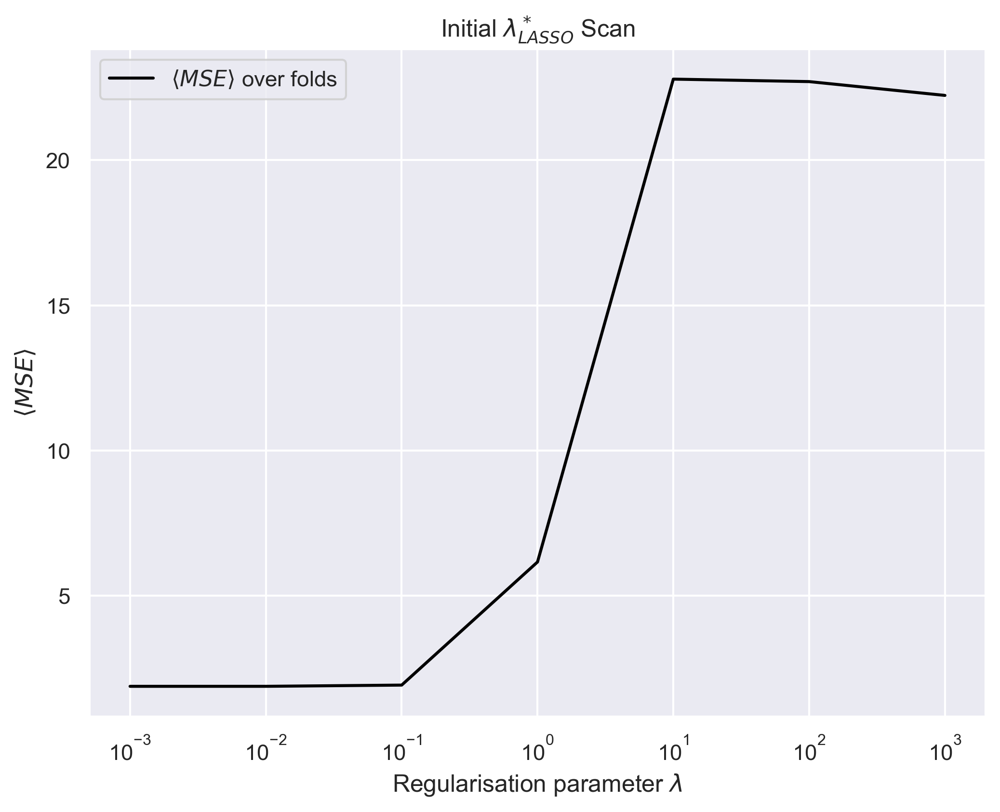

In [23]:
plt.plot(initial_lasso_scan[:,0], initial_lasso_scan[:,1], label="$\\langle MSE \\rangle$ over folds", color="black")
plt.xlabel("Regularisation parameter $\lambda$")
plt.ylabel("$\\langle MSE \\rangle$")
plt.title("Initial $\lambda_{LASSO}^*$ Scan")
plt.xscale("log")
plt.legend()
plt.show()

After completing an initial scan, it is clear $\lambda^*_{LASSO}\in[0,0.1]$. We perform a second scan to further increase the resolution, this time using $100$ values between $0$ and $0.1$:

In [24]:
mses_LASSO, optimal_pair_LASSO = test_lambdas(X_train, y_train, np.linspace(0, 0.1, 100), 5, threshold=1e-5, maxiter=10_000)
optimal_lambda_LASSO = optimal_pair_LASSO[0]

100%|██████████| 100/100 [00:51<00:00,  1.94it/s]


We now visualise how $\langle MSE\rangle$ changes when $\lambda$ is varied in LASSO regression:

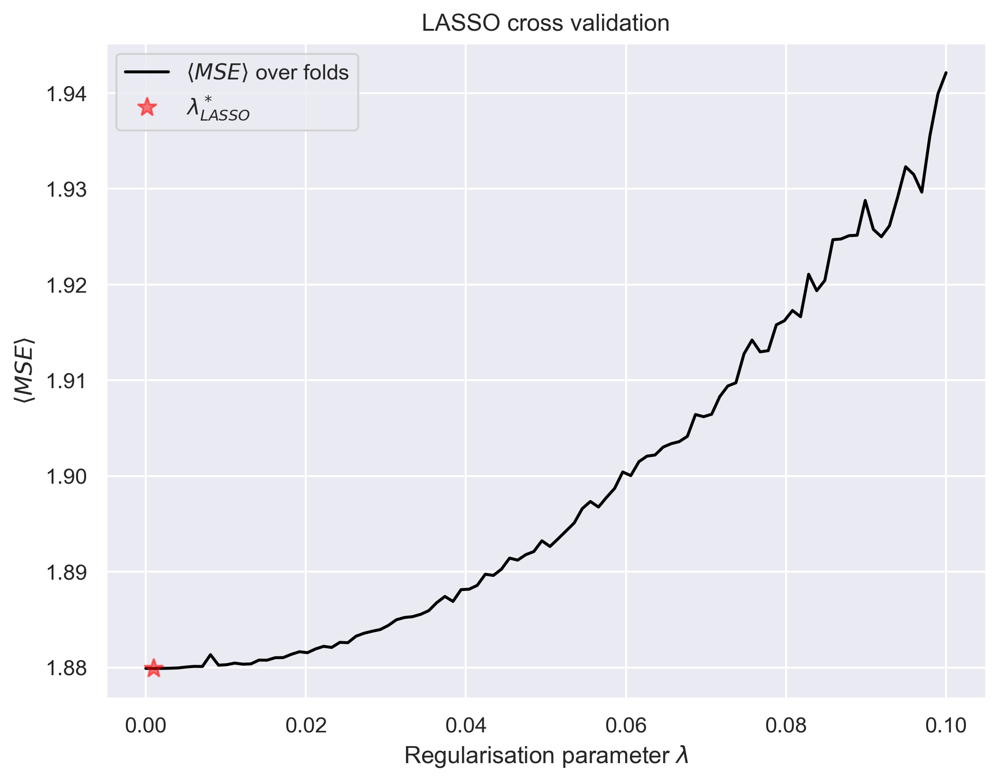

In [25]:
plt.plot(mses_LASSO[:,0], mses_LASSO[:,1], label="$\\langle MSE \\rangle$ over folds", color="black")
plt.plot(optimal_pair_LASSO[0], optimal_pair_LASSO[1], "*", label="$\lambda^*_{LASSO}$", color="red", markersize=10, alpha=0.5)
plt.xlabel("Regularisation parameter $\lambda$")
plt.ylabel("$\\langle MSE \\rangle$")
plt.title("LASSO cross validation")
plt.legend()
plt.show()

We display $\lambda_{LASSO}^*$ and the optimal value of $\langle MSE \rangle$ for completeness:

In [26]:
print("The optimal lambda for LASSO is: ", optimal_pair_LASSO[0])
print("The optimal average MSE for LASSO is: ", optimal_pair_LASSO[1])

The optimal lambda for LASSO is:  0.00101010101010101
The optimal average MSE for LASSO is:  1.8798973571799167


##### 1.2.2

We now visualise what happens to the components of the feature vector $\beta^*_{LASSO,\,\lambda}$ as we vary our value of lambda; we first define a function to generate $\beta^*_{LASSO,\lambda_{i}}$ given array of $\lambda_i$ values:

In [27]:
def generate_betas(fold, lambdas, threshold=1e-5, maxiter=10_000):
    """
    Generate betas for a given fold
    Args:
        fold: (dict) dictionary of the form:
        {"X_train" : X_training, "y_train" : y_training, "X_val": X_val, "y_val" : y_val}
        lambdas: (np.array) 1xL array of lambdas to test
        maxiter: (int) maximum number of iterations
    Returns:
        betas: (np.array) Lx(D+1) array of the form [[lambda_1, beta_1], ..., [lambda_L, beta_L]]
    """
    X_training = fold["X_train"] # get training predictor matrix from the fold
    y_training = fold["y_train"] # get training outcome vector from the fold
    betas = []
    for lam in tqdm(lambdas):
        # compute predicted beta
        predicted_beta = gradient_descent_lasso(beta_star, X_training, y_training, lam, threshold=threshold, maxiter=maxiter) 
        # store the lambda and the predicted beta
        betas.append(np.vstack([lam, predicted_beta]))
    return np.asarray(betas)

We now fix a fold and generate the betas for said fold.

In [28]:
fixed_fold = generate_folds(X_train, y_train, 5)["Fold 0"]
generated_betas = generate_betas(fixed_fold, np.linspace(0, 3, 51), threshold=1e-5, maxiter=5_000)

100%|██████████| 51/51 [02:29<00:00,  2.94s/it]


We now display how the components of $\beta^*_{LASSO,\,\lambda}$ evolve as $\lambda$ grows. Let $\mathbf{v}^i$ be the $i$ th component of the vector $\mathbf{v}$, using $0$-based indexing (this is so $(\beta_{aug})^0 = \beta_0$); then:

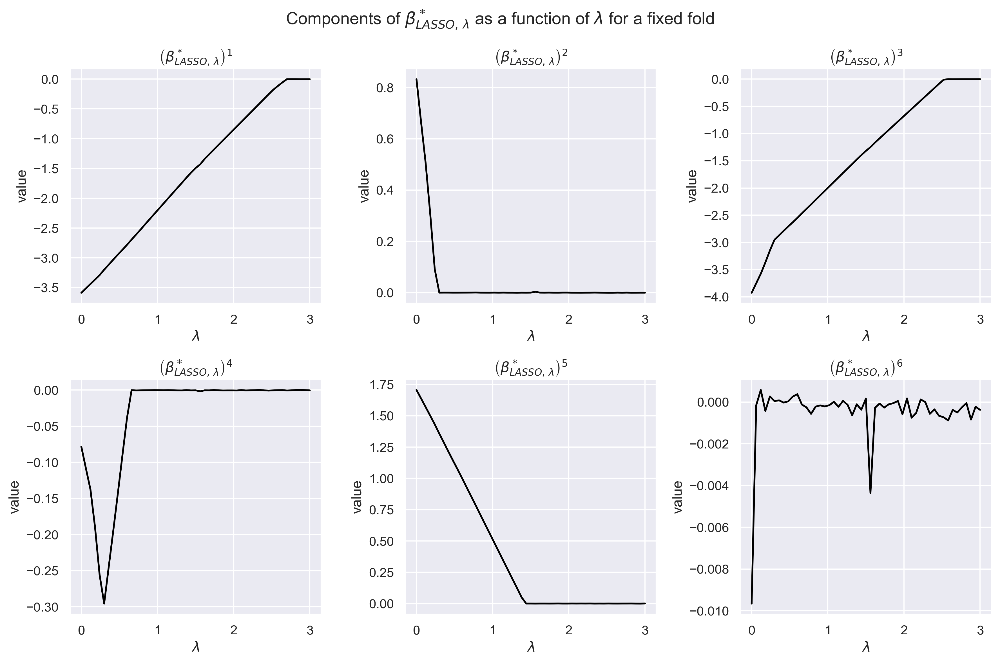

In [109]:
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i, ax in enumerate(axes.flatten()):
    ax.plot(generated_betas[:,0], generated_betas[:,i+2], color="black")
    ax.set_xlabel("$\lambda$")
    ax.set_title(f"$\left(\\beta^*_{{LASSO,\,\lambda}}\\right)^{{{i+1}}}$")
    ax.set_ylabel("value")

fig.suptitle("Components of $\\beta^*_{LASSO,\,\lambda}$ as a function of $\lambda$ for a fixed fold")
plt.tight_layout()
plt.show()


We can see that as lambda increases, $\left(\beta_{LASSO,\,\lambda}^*\right)^i\to 0$, $i\neq 0$. This is due to the $L_1$-norm term in the LASSO loss function, which induces sparsity in $\beta$. However, we can see some outliers; we see that $\beta_5$ does not tend to $0$ montonically, and that $\beta_7$'s value fluctuates when $\lambda$ reaches around $0.5$; these behaviours can be attributed to numerical artifacts, especially the latter.

This behaviour occurs due to the sparsity-inducing nature of the $L_1$ norm; we note that the LASSO loss function has the following dual formulation:
$$
\min_{\beta}\|\mathbf{X}\beta- y\|_2^2 \text{ such that } \|\beta\|_1\leq k
$$

For some $k = k(\lambda)$, where the relation is inversely proportional (as $\lambda$ increases, $k$ decreases, not necessarily reciprocally/linearly). Therefore, when $\lambda$ increases and thus $k$ decreases, the predicted features must be closer to the origin and due to the sparsity-inducing property of the $L_1$ norm, $\beta\to\mathbf{0}$. This induces a bias in $\beta$, as $\beta$ is the induced sparsity drives it away from its true optimal value, $\beta^*$, meaning $\mathbb{E}[\beta] - \beta = \beta^*-\beta$ increases. However, the variance is reduced as sparsity decreases variance due to the coefficients of $\beta$ being more localised; this yields reduced variance because as the values of $\beta$ are more constrained as $\lambda$ increases, the possible values $\beta$ may take decreases. 

Here, we have omitted the intercept term, as our loss function does not regularise over $\beta_0$. We now plot $\beta_0$:

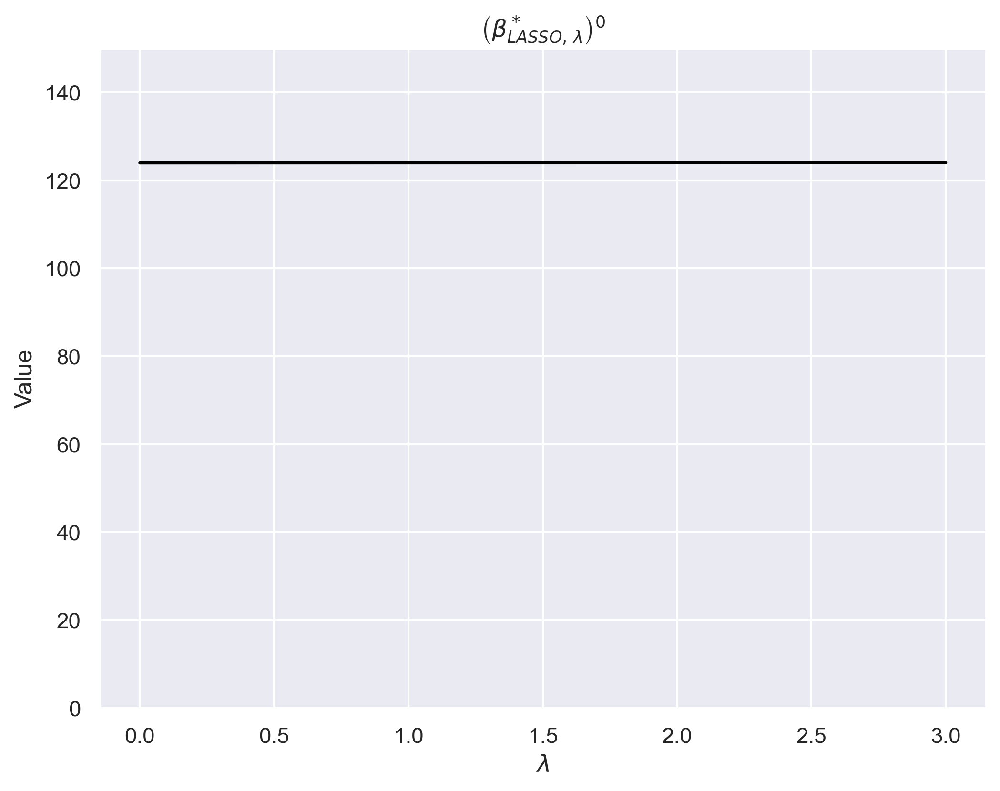

In [30]:
plt.plot(generated_betas[:,0], generated_betas[:,1], label="$\\beta_1$", color="black")

plt.xlabel("$\lambda$")
plt.ylabel("Value")
plt.title("$\left(\\beta^*_{LASSO,\,\lambda}\\right)^0$")
plt.ylim(-0.1, 150)
plt.show()

As we are not regularising over $\beta_0$, we can see it stays constant regardless of the value of $\lambda$, as expected.

##### 1.2.3

We now find $\beta_{LASSO,\lambda^*}^*$ and compute the in-sample and out-of-sample $MSE$ s and $R^2$ errors:

In [31]:
beta_star_lasso = gradient_descent_lasso(beta_star, X_train, y_train, optimal_lambda_LASSO, 10_000)
print("In sample MSE: " + str(compute_mse(X_train, y_train, beta_star_lasso))) # in sample MSE
print("In sample R2: " + str(compute_R2(X_train, y_train, beta_star_lasso))) # in sample R2
print()
print("Out of sample MSE: " + str(compute_mse(X_test, y_test, beta_star_lasso))) # out of sample MSE
print("Out of sample R2: " + str(compute_R2(X_test, y_test, beta_star_lasso))) # out of sample R2

In sample MSE: 1.8755614954545592
In sample R2: 0.9177341847407415

Out of sample MSE: 1.9838701234315852
Out of sample R2: 0.9083412457539801


Once again, we observe that the model performs better out of sample than in sample. We now discuss the differences between $\beta^*$ and $\beta_{LASSO}^*$:

In [32]:
print("The difference between the LASSO beta and the true beta is: ")
print(np.abs(beta_star_lasso-beta_star))
print()
print("The L1 norm of the LASSO optimal beta is: {}".format(np.linalg.norm(beta_star_lasso, ord=1)))
print("The L1 norm of the least squares optimal beta is: {}".format(np.linalg.norm(beta_star, ord=1)))
print()
print("As a reminder, the optimal value of lambda for LASSO is: {}".format(optimal_lambda_LASSO))
print()

The difference between the LASSO beta and the true beta is: 
[[1.42108547e-14]
 [1.01010101e-03]
 [1.01010101e-03]
 [1.01010101e-03]
 [1.01010101e-03]
 [1.01010101e-03]
 [1.01010101e-03]]

The L1 norm of the LASSO optimal beta is: 134.1196991219072
The L1 norm of the least squares optimal beta is: 134.12575972796782

As a reminder, the optimal value of lambda for LASSO is: 0.00101010101010101



We start by noting that the small difference in $\beta_0$ is due to the regularisation not affecting $\beta_0$, thus the intercept terms of both $\beta^*$ and $\beta^*_{LASSO}$ remain identical up to a very small precision that can be attributed up to numerical error.

We note that all other terms in $\beta^*$ and $\beta^*_{LASSO}$ differ by exactly $\lambda^*_{LASSO}$. 

Moreover, we can see that the $L_1$ norm of $\beta_{LASSO}^*$ is less than the $\beta^*$, as expected, as we LASSO penalises $\beta$ having a large $L_1$ norm and thus forces $\|\beta\|_1$ to decrease.

Lastly, we recall our $MSE$ and $R^2$ scores for $\beta^*$ and $\beta_{LASSO}^*$:

In [33]:
print("In sample MSE (LS Beta): " + str(compute_mse(X_train, y_train, beta_star))) # in sample MSE
print("In sample R2 (LS Beta): " + str(compute_R2(X_train, y_train, beta_star))) # in sample R2
print()
print("Out of sample MSE (LS Beta): " + str(compute_mse(X_test, y_test, beta_star))) # in sample MSE
print("Out of sample R2 (LS Beta): " + str(compute_R2(X_test, y_test, beta_star))) # in sample R2
print("------------------------------------")
print("In sample MSE (LASSO Beta): " + str(compute_mse(X_train, y_train, beta_star_lasso))) # in sample MSE
print("In sample R2 (LASSO Beta): " + str(compute_R2(X_train, y_train, beta_star_lasso))) # in sample R2
print()
print("Out of sample MSE (LASSO Beta): " + str(compute_mse(X_test, y_test, beta_star_lasso))) # out of sample MSE
print("Out of sample R2 (LASSO Beta): " + str(compute_R2(X_test, y_test, beta_star_lasso))) # out of sample R2

In sample MSE (LS Beta): 1.8755566396402015
In sample R2 (LS Beta): 0.9177343977263077

Out of sample MSE (LS Beta): 1.9843895771191569
Out of sample R2 (LS Beta): 0.9083172459581623
------------------------------------
In sample MSE (LASSO Beta): 1.8755614954545592
In sample R2 (LASSO Beta): 0.9177341847407415

Out of sample MSE (LASSO Beta): 1.9838701234315852
Out of sample R2 (LASSO Beta): 0.9083412457539801


We can see that the in-sample $MSE$ is smaller and thus better for $\beta^*$. Similarly, in-sample $R^2$ is greater and better for $\beta^*$ than for $\beta^*_{LASSO}$. However, we note that $\beta^*_{LASSO}$ performs better out-of-sample, as it has lower out-of-sample $MSE$ and higher out-of-sample $R^2$ than $\beta^*$; this agrees with our expectations as LASSO introduces bias into our $\beta$ to reduce its variance in order to diminish its generalisation error, which it manages to do in this instance.

#### 1.3 Elastic Nets (20 marks) 

##### 1.3.1

We now train a model using elastic net regularisation, whose loss function is given by:


$$
L_{EN}(\beta_0,\beta) = \frac{1}{2N}\|\mathbf{y}-\mathbf{X}\beta - \beta_0 \|^2 + \lambda(\alpha\|\beta\|_1 + (1-\alpha)\|\beta\|_2^2)
$$

Augmenting $\mathbf{X}$ yields:

$$
L_{EN}(\beta_{aug}) = \frac{1}{2N}\|\mathbf{y}-\mathbf{X}_{aug}\beta_{aug}\|^2 + \lambda\left(\alpha\left\|\begin{bmatrix} 0 \\ \beta\end{bmatrix}\right\|_1 + (1-\alpha)\left\|\begin{bmatrix} 0 \\ \beta\end{bmatrix}\right\|_2^2\right)
$$

We differentiate w.r.t. $\beta_{aug}$ to find the gradient to do gradient descent. This yields:

$$
\nabla_{\beta_{aug}}L_{EN}(\beta_{aug}) =  \frac{1}{N}(\mathbf{X}_{aug}^\top(\mathbf{X}_{aug}\beta_{aug} - \mathbf{y})) + \lambda\left( \alpha\, sgn.\left(\begin{bmatrix} 0 \\ \beta\end{bmatrix}\right) + (1-\alpha)\begin{bmatrix} 0 \\ \beta\end{bmatrix}\right)
$$

This is implemented below:

In [34]:
def en_loss(beta_aug, X, y, lam, alpha):
    """
    Compute the elastic net loss function
    Args:
        beta_aug: (np.array) (D+1)x1 augmented feature vector
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        lam: (float) elastic net penalty parameter
        alpha: (float) elastic net mixing parameter
    Returns:
        loss: (float) elastic net loss
    """
    N, _ = np.shape(X) # get the number of observations
    X_aug = augment(X) # augment the predictor matrix
    # compute the regularisation term
    reg_term = lam * (alpha * np.linalg.norm(np.vstack([0, beta_aug[1:]]), ord=1) + (1-alpha) * np.linalg.norm(np.vstack([0, beta_aug[1:]]), ord=2)**2)
    return (1/(2*N)) * np.linalg.norm(y-X_aug@beta_aug)**2  + reg_term

def en_loss_grad(beta_aug, X, y, lam, alpha):
    """
    Compute the gradient of the elastic net loss function
    Args:
        beta_aug: (np.array) (D+1)x1 augmented feature vector
        X: (np.array) NxD predictor matrix 
        y: (np.array) Nx1 predicted variable vector
        lam: (float) elastic net penalty parameter
        alpha: (float) elastic net mixing parameter
    Returns:
        loss_grad: (np.array) (D+1)x1 gradient of elastic net loss
    """
    N, _ = np.shape(X) # get the number of observations
    X_aug = augment(X) # augment the predictor matrix
    return (1/N) * (X_aug.T @ (X_aug@beta_aug-y)) + lam * (alpha * np.sign(np.vstack([0, beta_aug[1:]]))  + (1-alpha) * np.vstack([0, beta_aug[1:]]))

We now implement gradient descent for $\beta_{aug}$ for the Elastic Net loss function. Using the same notation as in section 1.2.1, our gradient descent will stop when one of the following happens:

* We reach a maximum number of iterations, `maxiter` (set to $10^4$ by default)
* When $i = 2^n$ for some n, if $|L_{EN}^{i+1} - L_{EN}^{i}|<L_{EN}^{i}\cdot$ `threshold` $\quad$ (where `threshold` is set to $10^{-5}$ by default)

In [35]:
def gradient_descent_en(beta_in, X, y, lam, alpha, threshold = 1e-5, maxiter=10_000):
    """
    Perform gradient descent to find the elastic net optimal beta_aug
    Args:
        beta_in: (np.array) (D+1)x1 initial augmented feature vector
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        lam: (float) elastic net penalty parameter
        alpha: (float) elastic net mixing parameter
        threshold: (float) threshold for convergence
        maxiter: (int) maximum number of iterations
    Returns:
        beta_n: (np.array) (D+1)x1 elastic net optimal augmented feature vector
    """
    beta_n = beta_in # initialise beta
    dl_beta_n = en_loss_grad(beta_n, X, y, lam, alpha) # compute gradient
    prev_loss = np.inf # initialise previous loss
    loss = en_loss(beta_n, X, y, lam, alpha) # compute loss
    j = 1 # initialise iteration counter
    nth = 0 # initialise stepsize counter
    stepsize =  (1 / j) # initialise stepsize
    while j < maxiter and np.abs(prev_loss - loss)>=prev_loss*threshold: # check convergence
        if j == 2**nth: # check if stepsize should be updated
            nth += 1 # update stepsize counter
            prev_loss = en_loss(beta_n, X, y, lam, alpha) # compute previous loss
            beta_n = beta_n - stepsize*dl_beta_n # update beta
            dl_beta_n = en_loss_grad(beta_n, X, y, lam, alpha) # compute new gradient
            loss = en_loss(beta_n, X, y, lam, alpha) # compute new loss
        else:
            beta_n = beta_n - stepsize*dl_beta_n # update beta
            dl_beta_n = en_loss_grad(beta_n, X, y, lam, alpha) # compute new gradient
        j += 1 # update iteration counter
        stepsize = (1 / j) # update stepsize
    return beta_n

##### 1.3.2

We now perform grid search over $\alpha = 0.1,0.5, 0.9 $ and $\lambda\in[0,0.01]$; we first implement functions to: 

* Score a given pair $(\alpha,\lambda)$ and another 
* Iterate over all $(\alpha, \lambda)$ pairs, score them and find the optimal $\lambda$ for a given $\alpha$, denoted as $\lambda^*_{\alpha}$

Once again, we initialise $\beta$ to the optimal least squares $\beta$, $\beta^*$, as the assumption that the regularisation won't move the value of $\beta$ far away from $\beta^*$ can still be made.

In [36]:
def en_cross_validation_score(X, y, nfolds, lam, alpha, threshold=1e-5, maxiter=10_000):
    """
    Compute the mean squared error of the elastic net model using cross validation
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        nfolds: (int) number of folds
        lam: (float) elastic net penalty parameter
        alpha: (float) elastic net mixing parameter
        threshold: (float) threshold for convergence
        maxiter: (int) maximum number of iterations
    Returns:
        mse: (float) mean squared error of the elastic net model
    """
    folds = generate_folds(X, y, nfolds) # generate folds
    mses = [] # initialise list of mean squared errors
    for fold in folds.values(): # iterate over folds
        X_training = fold["X_train"] # extract training data
        y_training = fold["y_train"] # extract training labels
        X_val = fold["X_val"] # extract validation data
        y_val = fold["y_val"] # extract validation labels
        predicted_beta = gradient_descent_en(beta_star, X_training, y_training, lam, alpha, threshold=threshold, maxiter=maxiter) # compute optimal beta
        mses.append(compute_mse(X_val, y_val, predicted_beta)) # compute mean squared error and append it to the list
    return np.mean(mses) # return the mean of the mean squared errors


def en_test_lambdas(X, y, lambdas, alphas, nfolds, threshold=1e-5, maxiter=10_000):
    """
    Compute the mean squared error of the elastic net model for different lambdas
    Args:
        X: (np.array) NxD predictor matrix
        y: (np.array) Nx1 predicted variable vector
        lambdas: (np.array) Lx1 array of lambdas
        alphas: (np.array) Ax1 array of alphas
        nfolds: (int) number of folds
        threshold: (float) threshold for convergence
        maxiter: (int) maximum number of iterations
    Returns:
        mse_arrs: (np.array) AxLx2 array of mean squared errors and lambdas
        
    """
    mse_arrs = [] # initialise list of mean squared errors for each alpha and lambda
    optimal_pairs = [] # initialise list of optimal alpha and lambda pairs
    for alpha in tqdm(alphas): # iterate over alphas
        mse_arr = [] # initialise list of mean squared errors for each lambda
        for lam in tqdm(lambdas): # iterate over lambdas
            mse_arr.append([lam, en_cross_validation_score(X, y, nfolds, lam, alpha, threshold=threshold, maxiter=maxiter)]) # compute mean squared error and append it to the list
        mse_arr = np.asarray(mse_arr) # convert list to array
        mse_arrs.append([alpha, mse_arr]) # append array to list
        optimal_pair = mse_arr[np.argmin(mse_arr[:,1])] # compute optimal lambda
        optimal_pairs.append(np.concatenate([[alpha],optimal_pair])) # append optimal lambda to list
    return np.asarray(mse_arrs, dtype=object), np.asarray(optimal_pairs) # return arrays

We now compute $\lambda^*_{0.1},\lambda^*_{0.5}$ and $\lambda^*_{0.9}$:

In [37]:
mse_arrs, pairs = en_test_lambdas(X_train, y_train, np.linspace(0, 0.01, 51),\
                         [0.1,0.5,0.9], 5, threshold=1e-6, maxiter=5_000) # compute mean squared errors for different lambdas

100%|██████████| 3/3 [01:18<00:00, 26.08s/it]


We display the pairs $(\alpha, \lambda_{\alpha}^*, \langle MSE\rangle^*_{\alpha})$, where $\langle MSE\rangle^*_{\alpha}$ is the best average $MSE$ over the folds for a given $\alpha$:

In [38]:
for i in range(3): # iterate over alphas
    print("alpha = ", pairs[i,0]) # print alpha
    print("optimal lambda = ", pairs[i,1]) # print optimal lambda
    print("optimal mse = ", pairs[i,2]) # print optimal mse
    print()

alpha =  0.1
optimal lambda =  0.0002
optimal mse =  1.879952681679405

alpha =  0.5
optimal lambda =  0.0004
optimal mse =  1.8799601083775783

alpha =  0.9
optimal lambda =  0.0012000000000000001
optimal mse =  1.8799620776179111



The results above are shown in the plot below; in the following graph, let $\langle MSE\rangle_\alpha$ be the $\langle MSE\rangle$ curve associated with the elastic net mixing parameter $\alpha$.

100%|██████████| 3/3 [00:00<00:00, 170.99it/s]


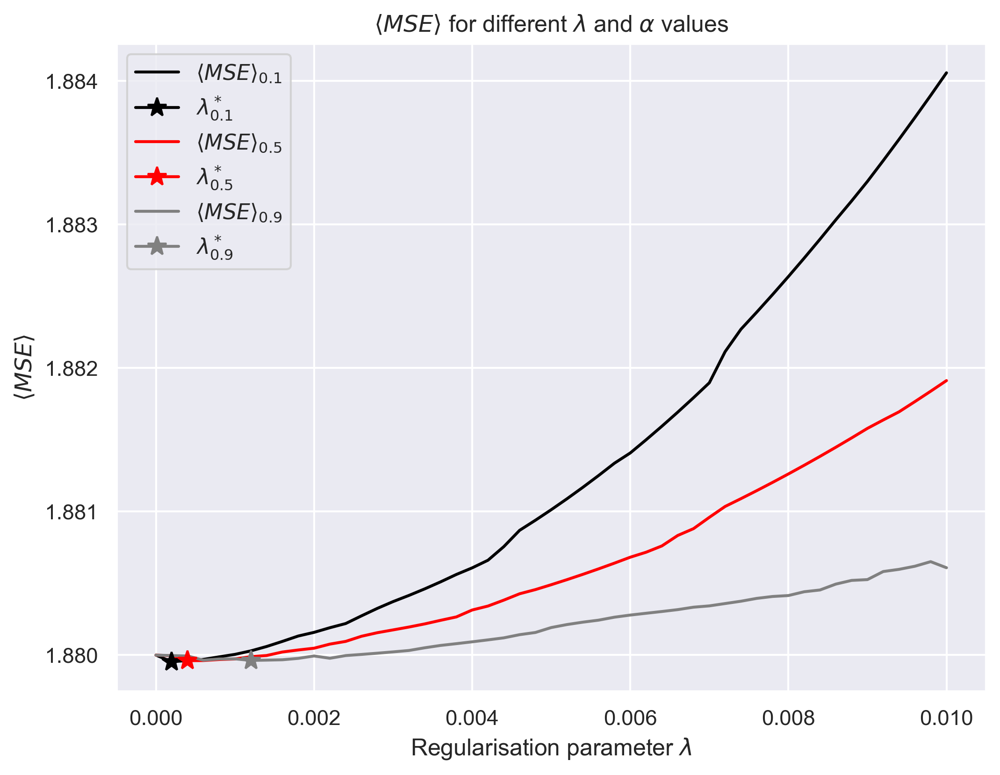

In [39]:
colors = ["black", "red", "grey"]

for i in tqdm(range(len(mse_arrs))):
    alpha = mse_arrs[i][0] # extract alpha
    mses_alphas = mse_arrs[i][1] # extract mean squared errors
    plt.plot(mses_alphas[:,0], mses_alphas[:,1], \
    label="$\langle MSE\\rangle_{{{alpha}}}$".format(alpha=alpha), color=colors[i]) # plot mean squared errors
    plt.plot(pairs[i,1], pairs[i,2], \
     marker="*", label="$\lambda^*_{{{alpha}}}$".format(alpha=alpha), color=colors[i], zorder=1000, markersize=10) # plot optimal lambda
    plt.xlabel("Regularisation parameter $\lambda$") # set x label
    plt.ylabel("$\langle MSE\\rangle$") # set y label

plt.title("$\langle MSE\\rangle$ for different $\lambda$ and $\\alpha$ values")
plt.legend()
plt.show()  


We display $\lambda^*_{0.1}, \lambda^*_{0.5}, \lambda^*_{0.9}$

In [40]:
print("For Alpha = 0.1, the optimal lambda is", pairs[0,1])
print("For Alpha = 0.5, the optimal lambda is", pairs[1,1])
print("For Alpha = 0.9, the optimal lambda is", pairs[2,1])

For Alpha = 0.1, the optimal lambda is 0.0002
For Alpha = 0.5, the optimal lambda is 0.0004
For Alpha = 0.9, the optimal lambda is 0.0012000000000000001


Let $\beta^*_{EN,\alpha}$ be the augmented feature vector that minimises the $\langle MSE \rangle$ across all cross-validation folds for a fixed $\alpha$ (using the notation from 1.2, this can also be expressed as $\beta^*_{EN,\lambda^*_\alpha}$)

Having $\lambda_{0.1}^*,\lambda_{0.5}^*$ and $\lambda_{0.9}^*$, we now compute $\beta^*_{EN,\alpha}$ on the whole train set and use this to calculate the out-of-sample $MSE$ and $R^2$ scores for $\alpha=0.1,0.5,0.9$

In [41]:
beta_stars_en = [] # initialise list of optimal betas for the alpha range
for alpha, lam, _ in pairs:
    print("Alpha = " + str(alpha))
    beta_star_en = gradient_descent_en(beta_star, X_train, y_train, lam, alpha, 5_000) # compute optimal beta
    beta_stars_en.append(np.vstack([alpha,beta_star_en])) # append optimal beta to list
    print("Out of sample MSE: " + str(compute_mse(X_test, y_test, beta_star_en))) # out of sample MSE
    print("Out of sample R2: " + str(compute_R2(X_test, y_test, beta_star_en))) # out of sample R2
    print()


Alpha = 0.1
Out of sample MSE: 1.9843642929376566
Out of sample R2: 0.9083184141377478

Alpha = 0.5
Out of sample MSE: 1.9842699947212405
Out of sample R2: 0.9083227709033154

Alpha = 0.9
Out of sample MSE: 1.9838262587927602
Out of sample R2: 0.9083432723877313



Based on these metrics, one can see that $\alpha=0.9$ yields the best model, as it has the lowest out-of-sample $MSE$ and highest $R^2$ score. Afterwards $\alpha=0.5$ gives the second best model, and $\alpha=0.1$ yields the worst model.

##### 1.3.3

We now widen our range of $\alpha$ s used in our grid search and find $\lambda_\alpha^*$ for each $\alpha$; in our case, $\alpha = 0,0.2,0.4, 0.5, 0.6,0.8, 1$

In [42]:
alphas = [0,0.2,0.4,0.5,0.6,0.8,1]
full_mse_arrs, full_pairs = en_test_lambdas(X_train, y_train, np.linspace(0, 0.01, 101), alphas, 5, threshold=1e-6, maxiter=5_000)

100%|██████████| 7/7 [05:23<00:00, 46.26s/it]


We display $\alpha, \lambda^*_\alpha$ and $\langle MSE \rangle ^*_\alpha$:

In [43]:
for i in range(len(full_mse_arrs)):
    print("Alpha = ", full_pairs[i,0])
    print("Optimal Lambda = ", full_pairs[i,1])
    print("Optimal MSE = ", full_pairs[i,2])
    print()

Alpha =  0.0
Optimal Lambda =  0.0002
Optimal MSE =  1.8799605950559788

Alpha =  0.2
Optimal Lambda =  0.0002
Optimal MSE =  1.8799583588620206

Alpha =  0.4
Optimal Lambda =  0.00030000000000000003
Optimal MSE =  1.8799601913778765

Alpha =  0.5
Optimal Lambda =  0.00030000000000000003
Optimal MSE =  1.8799521713375529

Alpha =  0.6
Optimal Lambda =  0.0004
Optimal MSE =  1.8799598898584293

Alpha =  0.8
Optimal Lambda =  0.0007
Optimal MSE =  1.8799598284563057

Alpha =  1.0
Optimal Lambda =  0.0008
Optimal MSE =  1.8799640091972871



We now recalculate $\beta^*_{EN,\alpha}$ on the whole train set for the values of $\alpha$ previously stated.

In [44]:
full_beta_stars_en = [] # initialise list of optimal betas for the extended alpha range
for alpha_v, lam_v, _ in tqdm(full_pairs):
    full_beta_star_en = gradient_descent_en(beta_star, X_train, y_train, lam_v, alpha_v, maxiter=10_000) # compute optimal beta
    full_beta_stars_en.append(np.vstack([alpha_v,full_beta_star_en])) # append optimal beta to list

full_beta_stars_en = np.asarray(full_beta_stars_en).squeeze() # convert list to array


100%|██████████| 7/7 [00:00<00:00, 562.12it/s]


We now visualise the evolution of the components of $\beta^*_{EN,\alpha}$ as $\alpha$ changes from $0$ to $1$. As before, $\left(\beta^*_{EN,\alpha}\right)^0$ has been excluded as it stays constant due to the Elastic Net loss function not regularising over $\left(\beta^*_{EN,\alpha}\right)^0$.

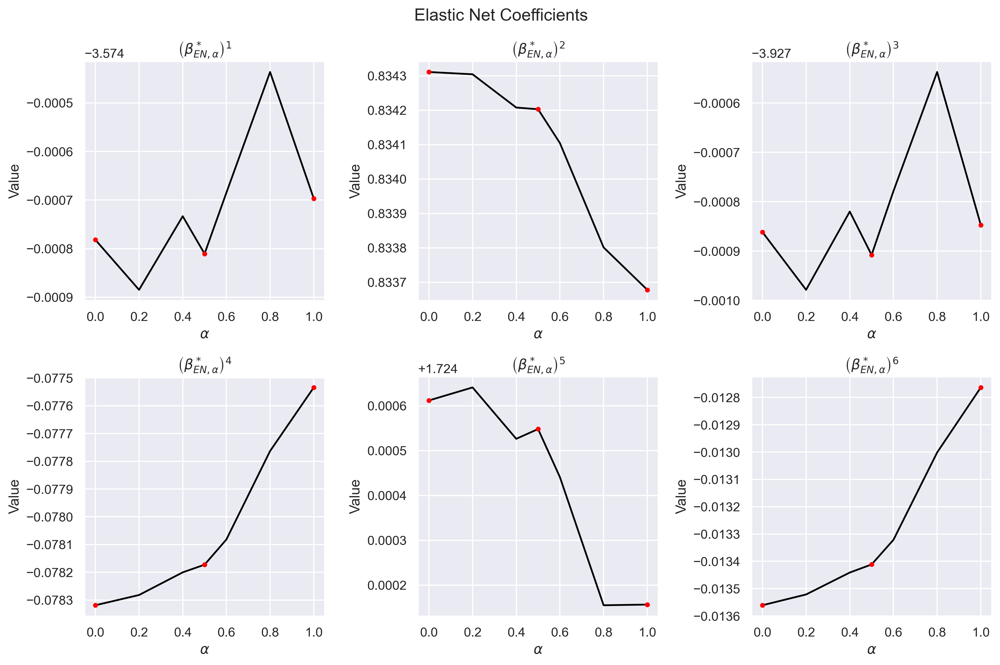

In [45]:
alphas = np.asarray(alphas)
alpha_indices = np.in1d(alphas, [0,0.5,1])
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
for i, ax in enumerate(axes.flatten()):
    #if full_beta_stars_en[:,0][i] == 0
    ax.plot(full_beta_stars_en[:,0], full_beta_stars_en[:,i+2], label="beta " + str(i+2), color="black")
    ax.scatter(full_beta_stars_en[:,0][alpha_indices], full_beta_stars_en[:,i+2][alpha_indices], color="red", zorder=1000, s=10)
    ax.set_xlabel("$\\alpha$")
    ax.set_ylabel("Value")
    ax.set_title("$\left(\\beta^*_{{EN,\\alpha}}\\right)^{{{comp}}}$".format(comp = i+1))

plt.suptitle("Elastic Net Coefficients")
plt.tight_layout()
plt.show()


Before starting this discussion, it is important to point out the difference between shrinkage and sparsity; whilst they both follow the same idea, that of feature selection and decreasing the values of features, shrinkage does so in a smooth manner, whilst sparsity achieves it in a non-smooth and thus more abrupt fashion.

We can see that, generally $|(\beta^*_{EN, \alpha})^i|$ decreases when $\alpha$ goes from $0$ to $1$; this is due to the $L_1$ norm's sparsity inducing property and the $L_2$'s shrinkage inducing property mixing in the elastic net loss function.As $\alpha$ goes from $0 \to 1$, by inspecting the formula we see we give more weighting to the $L_1$ norm, thus increasing the amount of sparsity induced into $\beta$ and reducing the shrinkage, making $\beta$'s coefficients decrease in absolute value.

When $\alpha = 0$, the Elastic Net loss function turns into the Ridge loss function, and thus the coefficients experience shrinkage instead of sparsity. 

When $\alpha = 0.5$, the loss function contains an equal amount of Ridge and LASSO regularisations, and thus we expect the value of $\beta^*_{EN, \alpha}$ to be an interpolation between $\beta^*_{LASSO, \lambda^*_\alpha}$ and $\beta^*_{Ridge, \lambda^*_\alpha}$, the optimal feature vector obtained using Ridge regularisation and regularisation parameter $\lambda^*_\alpha$; this is observed in the plot above. 

When $\alpha=1$, the Elastic Net loss function turns into the LASSO loss function, and thus the coefficients become sparse and their value decreases more towards $0$; this is what is observed, as the components $(\beta^*_{EN,\alpha})^i$ obtain their minimal value at $\alpha = 1$.

Lastly, we can see the plot above doesn't look smooth and presents many jagged edges and rough paths - these are numerical artifacts generated by the gradient descent function, as the Elastic Net gradient is non-differentiable and thus the stopping criterion used, which is an approximation to the subgradient of the Elastic Net, will yield irregularities in the final results due to the Elastic Net's loss function's nondifferentiable nature.

#### 1.4 kNN regression (10 marks)

##### 1.4.1

We are tasked to train a k-Nearest Neighbour (kNN) regression model on our airfoil dataset. We give a brief reminder of the $k$-Nearest Neighbour algorithm for regression. The aim of this algorithm is to find predict an outcome $y$ given a predictor vector $\mathbf{x}$ by looking at points in a neighbourhood of $\mathbf{x}$. This is done by choosing the $k$ closest points (typically, the Euclidean distance is used, but other metrics may be employed) to $\mathbf{x}$ and computing the average value of the outcome variable $y$ across these $k$ points. The algorithm may be summarised as follows:

1. Find the $k$ closest points to $\mathbf{x}_{in}$, denoted by $\{\mathbf{x}_i,y_i\}_{i=1}^k$
2. Set the predicted outcome, $\hat{y}_{in}$, to $\hat{y}_{in} = \frac{1}{k}\sum_{i=1}^k$

For kNN, it is important to standardise the input data $\mathbf{X}$, as if one feature's (denoted $\mathbf{X_{:,i}}$) differences varies more than the rest, it will dominate the Euclidean distance and thus one may fail to capture points that are close to $\mathbf{x}_{in}$ due to its distance being numerically high due to their difference in $\mathbf{X_{:,i}}$ being numerically high, when in fact they are relatively close w.r.t. $\mathbf{X_{:,i}}$. Therefore, we aim to give equal weighting to all of the features, and  standardising is crucial to doing so.

We start by defining an Euclidean distance function and a function that returns the $k$ closest points to a given input point.

In [46]:
def euclidean_distance(p, q):
  """
  Computes the euclidean distance between two points p and q.
  Args:
      p (np.array): A point in R^n
      q (np.array): A point in R^n
  Returns:
      dist (float): The euclidean distance between p and q
  """
  dist = np.linalg.norm(p - q,2, axis=1)
  return dist

def k_neighbours(X_in_train, X_in_test, k=5, return_distance=False):
  """
  Finds the k nearest neighbours of each point in X_test in X_train.
  Args:
      X_train (np.array): A matrix of shape (n_train, n_features)
      X_test (np.array): A matrix of shape (n_test, n_features)
      k (int): The number of neighbours to find
      return_distance (bool): If True, the function returns the distances
          between the points in X_test and their k nearest neighbours in X_train
  Returns:
      indices_arr (np.array): A matrix of shape (n_test, k) containing the indices of the
          k nearest neighbours of each point in X_test in X_train
      distances_arr (np.array): A matrix of shape (n_test, k) containing the distances between
          the points in X_test and their k nearest neighbours in X_train
          (only returned if return_distance is True)
  """
  dist = []
  neigh_ind = []
  # compute the euclidean distance between each point in X_test and each point in X_train
  point_dist = [euclidean_distance(x_test, X_in_train) for x_test in X_in_test] 

  for row in point_dist:
      enum_neigh = enumerate(row)
      sorted_neigh = sorted(enum_neigh, key=lambda x: x[1])[:k] # sort the distances and take the k smallest

      ind_list = [tup[0] for tup in sorted_neigh] # get the indices of the k smallest distances
      dist_list = [tup[1] for tup in sorted_neigh] # get the k smallest distances

      dist.append(dist_list) # append the k smallest distances to the list of distances
      neigh_ind.append(ind_list) # append the indices of the k smallest distances to the list of indices
  
  indices_arr = np.array(neigh_ind) # convert the list of indices to an array
  if return_distance: # if return_distance is True
    distances_arr = np.array(dist) # convert the list of distances to an array
    return distances_arr, indices_arr # return the array of distances and the array of indices
  
  return indices_arr # return the array of indices

def kNN_predict(X_in_train, y_in_train, X_in_test, k=5):
  """
  Predicts the output of each point in X_test using the k nearest neighbours
  in X_train.
  Args:
      X_train (np.array): A matrix of shape (n_train, n_features)
      y_train (np.array): A vector of shape (n_train,)
      X_test (np.array): A matrix of shape (n_test, n_features)
      k (int): The number of neighbours to use
  Returns:
      y_pred (np.array): A vector of shape (n_test,) containing the predicted output
          of each point in X_test
  """
  neighbours = k_neighbours(X_in_train, X_in_test, k=k) # get the indices of the k nearest neighbours
  y_pred = np.mean(y_in_train[neighbours], axis=1) # compute the mean of the outputs of the k nearest neighbours
  return y_pred

We now implement k-fold cross-validation for kNN:

In [47]:
def kNN_cross_validation_score(X, y, nfolds, k=5):
    """
    Computes the cross validation score for a kNN model using the MSE.
    Args:
        X (np.array): A matrix of shape (n_samples, n_features)
        y (np.array): A vector of shape (n_samples,)
        nfolds (int): The number of folds to use
        k (int): The number of neighbours to use
    Returns:
        avg_mse (float): The cross validation score
    """
    
    folds = generate_folds(X, y, nfolds) # generate the folds
    mse = [] 
    for fold in folds.values():
        # get the training and validation sets for the current fold
        X_train_fold = fold["X_train"]
        y_train_fold = fold["y_train"]
        X_val_fold = fold["X_val"]
        y_val_fold = fold["y_val"]
        # make predictions on the validation set
        y_pred = kNN_predict(X_train_fold, y_train_fold, X_val_fold, k)
        # compute the MSE and append it to the list of MSEs
        mse.append(np.mean((y_pred - y_val_fold)**2))
    # compute the average MSE over all folds
    avg_mse = np.mean(mse)
    return avg_mse

def optimise_k(X, y, nfolds, ks, return_mse=False):
    """
    Finds the optimal number of neighbours for a kNN model using cross
    validation.
    Args:
        X (np.array): A matrix of shape (n_samples, n_features)
        y (np.array): A vector of shape (n_samples,)
        nfolds (int): The number of folds to use
        ks (list): A list of integers containing the values of k to try
        return_mse (bool): If True, the function returns the list of MSEs
            corresponding to each value of k
    Returns:
        best_k (int): The optimal number of neighbours
        mse (list): A list of floats containing the MSEs corresponding to
            each value of k (only returned if return_mse is True)
    """
    mse = []
    for k in tqdm(ks):
        # compute the MSE for the current value of k
        mse.append(kNN_cross_validation_score(X, y, nfolds, k))
    # find the value of k that minimises the MSE
    best_k = ks[np.argmin(mse)]
    if return_mse: # if return_mse is True
        return best_k, mse # return the list of MSEs
    return best_k # return the best value of k

We now compute the optimal value of $k$, $k^*$, for this regression task. Additionally, we return the $\langle MSE \rangle$ for each value of $k$, denoted as $\langle MSE \rangle_k$ to better visualise why $k^*$ is the best value of $k$. We test $k\in\{1,2,\dots,30\}$. To do this, we perform $5$-fold cross validation on our training dataset:

In [48]:
optimal_k, mses = optimise_k(X_train, y_train, 5, [i for i in range(1, 31)], return_mse=True)

100%|██████████| 30/30 [09:17<00:00, 18.57s/it] 


In [49]:
print("For kNN regression, the optimal number of neighbours is {}.".format(optimal_k))

For kNN regression, the optimal number of neighbours is 7.


We now plot $k$ against $\langle MSE\rangle_k$:

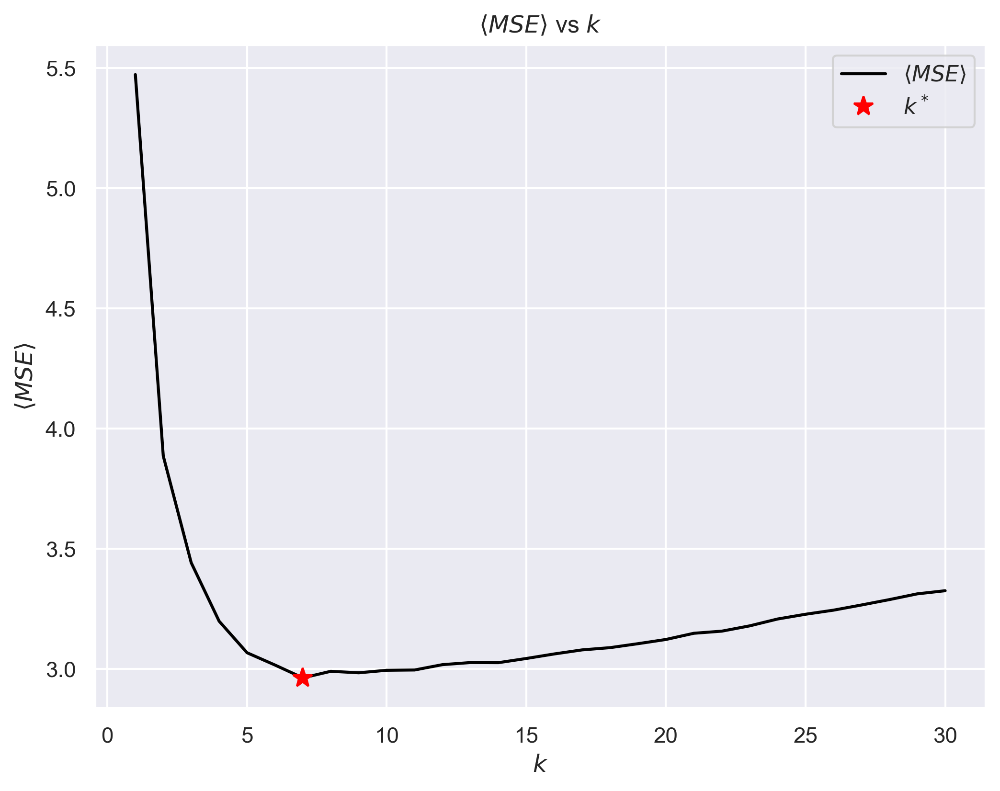

In [50]:
plt.plot([i for i in range(1, 31)], mses, label="$\langle MSE\\rangle$", color="black")
plt.plot(optimal_k, min(mses), '*', label="$k^*$", color="red", markersize=10)
plt.xlabel("$k$")
plt.ylabel("$\langle MSE\\rangle $")
plt.legend()
plt.title("$\langle MSE\\rangle$ vs $k$")
plt.show()

##### 1.4.2

In [51]:
predicted_ys = kNN_predict(X_train, y_train, X_test, optimal_k)
oos_mse = np.mean((predicted_ys-y_test)**2)
print("The out-of-sample MSE for kNN regression is {}.".format(oos_mse))

The out-of-sample MSE for kNN regression is 2.989671223395431.


We can see that the out-of-sample $MSE$ for the optimal value of $k$ found through $5$-fold cross-validation, $k^*$, is significantly higher than the out-of-sample $MSE$ of the linear regression model & its variants. 

This supports the claim that a linear model is an adequate descriptor of the relationship between predictors and outcomes, as linear models perform better than kNN, which is local, nonparametric and doesn't take in account linear relationships between predictors and outcomes.

## Task 2: Classification  (50 marks)



#### 2.1 Random forest (20 marks)
2.1.1

We are tasked to train a random forest classifier on a diabetes dataset using cross-entropy as the information criterion for the decision tree splits. We give a brief reminder on how random forests work:

Essentially, random forests are collections of decision trees that each predict an outcome, and in the end these outcomes are aggregated using a majority rule (if the majority of the trees classified $\mathbf{x}$ in $1$, the random forest will classify $\mathbf{x}$). Therefore, we turn our attention to decision trees.

Decision trees will split the sample space according to an information measure, such as GINI index, or in our case, Cross-Entropy. Decision trees sequentially choose the best value $s$ of a given feature $d$ that maximises the information measure after splitting the sample space by partitioning it into $\{\mathbf{x}: s \geq d\}$ and $\{\mathbf{x}: s < d\}$, until a desired precision is achieved.

To start our classification task, we first start by loading the data:

In [52]:
classification_train = pd.read_csv("data/diabetes_samples.csv")
classification_test = pd.read_csv("data/diabetes_test.csv")

We examine both the train and test sets to see if we have to clean the data:

In [53]:
classification_train.head() # display the first 5 rows of the training set

,patient_number,cholesterol,glucose,hdl_chol,chol_hdl_ratio,age,height,weight,bmi,systolic_bp,diastolic_bp,waist,hip,waist_hip_ratio,diabetes
0,115,224,85,30,"7,5",36,69,205,"30,3",150,99,37,41,"0,9",No diabetes
1,318,194,95,36,"5,4",63,58,210,"43,9",140,100,44,53,"0,83",No diabetes
2,73,207,75,44,"4,7",30,72,180,"24,4",118,62,35,41,"0,85",No diabetes
3,69,144,81,28,"5,1",30,72,165,"22,4",118,78,31,38,"0,82",No diabetes
4,326,181,177,24,"7,5",64,71,225,"31,4",130,66,44,47,"0,94",Diabetes


We test the type of the decimal entries, for example, bmi, to see if it's formatted as a `float` or a `str`:

In [54]:
type(classification_test.head()["bmi"][0]) # check the type of the bmi column

str

We observe the data must be cleaned by doing two things:

1. The decimals in this dataset are separated by a ",", instead of a ".". This means that these values, which should be interpreted as `floats` are read as `str`, meaning that we cannot perform arithmetic operations with them. Therefore, they must be changed to `floats` in order to be usable.
   
2. Our predicted variable has entries $\{\text{Diabetes}, \text{No diabetes}\}$. These must be mapped into `1` and `0` for classification.
   
Thankfully, using `pd.read`'s `decimal` keyword fixes 1., and using the `.map` method which is built into pandas DataFrames, we can map $\text{Diabetes}\to 1$, $\text{No diabetes}\to 0$, respectively.

Moreover, note that one of the variables we may use as a predictor in our dataset is patient number. However, it is obviously clear that a patient's number has nothing to do with the likelihood of them having diabetes or not, and for that reason we drop this column using pandas' `.drop` method. All of this is done below:

In [55]:
 # read the training data with the correct decimal separator
classification_train = pd.read_csv("data/diabetes_samples.csv", decimal=",")
classification_test = pd.read_csv("data/diabetes_test.csv", decimal=",")

# convert the diabetes column to a binary variable and drop the patient_number column
diabetes = {"No diabetes": 0, "Diabetes": 1}
class_X_train = classification_train.drop(["diabetes", "patient_number"], axis=1)
class_y_train = classification_train["diabetes"].map(diabetes)
class_X_test = classification_test.drop(["diabetes", "patient_number"], axis=1)
class_y_test = classification_test["diabetes"].map(diabetes)

We perform some exploratory data analysis by displaying some statistics of our training data:

In [56]:
classification_train.describe() # get some descriptive statistics

,patient_number,cholesterol,glucose,hdl_chol,chol_hdl_ratio,age,height,weight,bmi,systolic_bp,diastolic_bp,waist,hip,waist_hip_ratio
count,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000,273.000000
mean,199.695971,208.868132,108.864469,50.531136,4.493407,47.622711,66.032967,177.424908,28.690842,136.772894,82.553114,37.941392,43.102564,0.881062
std,115.880545,45.051737,55.762363,17.041255,1.573433,17.110598,3.867618,40.460071,6.560658,22.621073,13.161257,5.744903,5.834459,0.072060
min,1.000000,78.000000,52.000000,12.000000,2.000000,19.000000,55.000000,99.000000,17.200000,98.000000,50.000000,26.000000,32.000000,0.700000
25%,96.000000,179.000000,81.000000,39.000000,3.200000,34.000000,63.000000,151.000000,23.800000,121.000000,74.000000,33.000000,39.000000,0.830000
50%,198.000000,204.000000,90.000000,46.000000,4.200000,45.000000,66.000000,174.000000,27.900000,136.000000,82.000000,37.000000,42.000000,0.880000
75%,306.000000,232.000000,108.000000,59.000000,5.400000,61.000000,69.000000,200.000000,32.200000,148.000000,90.000000,42.000000,46.000000,0.930000
max,390.000000,404.000000,385.000000,120.000000,12.200000,92.000000,76.000000,308.000000,50.500000,250.000000,118.000000,53.000000,64.000000,1.090000


We now visualise our data using a pairplot:

In [117]:
sns.pairplot(classification_train, hue="diabetes", corner=True);
plt.suptitle("Pairplot of the diabetes dataset", y=1.05, fontsize=16)
plt.show()

We now standardise our data; this can be done as all of our variables are continuous or pseudo-continuous, as we can treat those variables that have values in $S\subseteq \mathbb{N}$, such as age, as continuous:

In [58]:
for col in class_X_train:
    class_X_train[col] = (class_X_train[col] - class_X_train[col].mean()) / class_X_train[col].std()

for col in class_X_test:
    class_X_test[col] = (class_X_test[col] - class_X_test[col].mean()) / class_X_test[col].std()

training_weights = np.ones_like(class_y_train) / len(class_y_train) # initialise the weights
columns_dict = {index: False for index in range(class_X_train.shape[1])} # initialise the dictionary of columns to use

class_X_train.head()

,cholesterol,glucose,hdl_chol,chol_hdl_ratio,age,height,weight,bmi,systolic_bp,diastolic_bp,waist,hip,waist_hip_ratio
0,0.335878,-0.427967,-1.204790,1.910849,-0.679270,0.767147,0.681538,0.245274,0.584725,1.249644,-0.163866,-0.360370,0.262806
1,-0.330023,-0.248635,-0.852703,0.576188,0.898700,-2.076981,0.805117,2.318237,0.142659,1.325625,1.054606,1.696376,-0.708609
2,-0.041466,-0.607300,-0.383254,0.131301,-1.029930,1.542819,0.063645,-0.654026,-0.829885,-1.561638,-0.512000,-0.360370,-0.431062
3,-1.439859,-0.499700,-1.322152,0.385522,-1.029930,1.542819,-0.307091,-0.958874,-0.829885,-0.345948,-1.208270,-0.874557,-0.847383
4,-0.618581,1.221891,-1.556877,1.910849,0.957143,1.284262,1.175853,0.412940,-0.299406,-1.257715,1.054606,0.668003,0.817900


Having cleaned the data, we now implement the cross-entropy function using weights, which will be used in deciding how to split a decision tree. As a reminder the formula for cross entropy is shown below:

In [59]:
def cross_entropy(y, sample_weights):
  """
  Calculates the cross entropy of a set of labels.
    Args:
        y (np.array): A vector of shape (n_samples,) containing the labels
        sample_weights (np.array): A vector of shape (n_samples,) containing
            the weights of each sample
    Returns:
        entropy (float): The cross entropy of the labels
  """
  label_weights = {yi: 0 for yi in set(y)} # initialise the dictionary of label weights
  for yi, wi in zip(y, sample_weights):
      label_weights[yi] += wi # update the weight of the current label

  total_weight = sum(label_weights.values()) # compute the total weight
  entropy = 0 # initialise the entropy
  for _, weight in label_weights.items():
      p = weight / total_weight # compute the probability of the current label
      entropy -= p * np.log(p) # update the entropy

  return entropy

We now implement splitting the samples, calculating cross-entropy for a given region:

$$
CE[\mathbf{\pi}(R_\alpha)] = -\sum_{q=1}^Q\pi_q(R_\alpha)\log\pi_q(R_\alpha)
$$

This measures how far the empirical CDF of classes, $\pi(R_\alpha)$, strays from a uniform distribution.

In [60]:
def split_samples(X, y, sample_weights, column, value, categorical):
  """
  Split the samples into two groups based on the value of `column`.
  Args:
      X: training features, of shape (N, D).
      y: vector of training labels, of shape (N,).
      sample_weights: weights for each samples, of shape (N,).
      column: the column to split on.
      value: the value to split on.
      categorical: whether the column is categorical or not.
  Returns:
      (X_left, X_right): the left and right split of X.
      (y_left, y_right): the left and right split of y.
      (w_left, w_right): the left and right split of sample_weights.
  """ 

  if categorical:
    left_mask =(X[:, column] == value) # if the column is categorical, we split on the value being equal to the threshold
  else:
    left_mask = (X[:, column] < value) # if the column is continuous, we split on the value being less than the threshold
  
  X_left, X_right = X[left_mask, :], X[~left_mask, :] # split the features
  y_left, y_right = y[left_mask], y[~left_mask] # split the labels
  w_left, w_right  = sample_weights[left_mask], sample_weights[~left_mask] # split the weights

  return (X_left, X_right), (y_left, y_right), (w_left, w_right)

def ce_split_value(X, y, sample_weights, column, categorical):
  """
  Calculate the cross entropy for a given column.
  Args:
      X (np.array): A matrix of shape (n_samples, n_features) containing the
        training data.
      y (np.array): A vector of shape (n_samples,) containing the labels
      sample_weights (np.array): A vector of shape (n_samples,) containing
        the weights of each sample
      column (int): The column to calculate the cross entropy for.
      categorical (bool): Whether the column is categorical or not.
  Returns:
      cross_entropy_val (float): The cross entropy of the column.
      threshold (float): The threshold to split on.
  """
  
  unique_vals = np.unique(X[:, column]) # get the unique values in the column

  assert len(unique_vals) > 1, f"There must be more than one distinct feature value. Given: {unique_vals}."

  cross_entropy_val, threshold = np.inf, None # initialise the cross entropy and threshold
  
  for value in unique_vals:
    # split the samples
    (X_l, X_r), (y_l, y_r), (w_l, w_r) = split_samples(X, y, sample_weights, column, value, categorical)

    if len(y_l) == 0 or len(y_r) == 0:
      continue
    
    p_left = sum(w_l)/(sum(w_l) + sum(w_r)) # compute the probability of the left split
    p_right = 1 - p_left # compute the probability of the right split
    new_cost = p_left * cross_entropy(y_l, w_l) + p_right * cross_entropy(y_r, w_r) # compute the new cross entropy
    if new_cost < cross_entropy_val: # update the cross entropy and threshold if the new cross entropy is lower
      cross_entropy_val, threshold = new_cost, value
    
  return cross_entropy_val, threshold

def majority_vote(y, sample_weights):
  """
  Majority vote for labels.
  Args:
      y (np.array): A vector of shape (n_samples,) containing the labels
      sample_weights (np.array): A vector of shape (n_samples,) containing
        the weights of each sample
  Returns:
      majority_label (int): The majority label.
  """
  majority_label = {yi: 0 for yi in set(y)} # initialise the dictionary of label weights

  for yi, wi in zip(y, sample_weights):
    majority_label[yi] += wi # update the weight of the current label
  return max(majority_label, key=majority_label.get) # return the label with the highest weight

We now implement a function to split the data based on the minimum cross entropy across columns.

In [61]:
def ce_split_rf(n_features, X, y, sample_weights, columns_dict):
  """
  Random forest cross entropy split. Split the data based on the minimum
  cross entropy.
  Args:
      n_features (int): The number of features to consider when splitting.
      X (np.array): A matrix of shape (n_samples, n_features) containing the
        training data.
      y (np.array): A vector of shape (n_samples,) containing the labels
      sample_weights (np.array): A vector of shape (n_samples,) containing
        the weights of each sample
      columns_dict (dict): A dictionary of column indices and whether they are
        categorical or not.
  Returns:
      min_ce (float): The minimum cross entropy.
      split_column (int): The column to split on.
      split_val (float): The value to split on.
  """
  columns = np.random.choice(list(columns_dict.keys()), n_features, replace=False) # select n_features random columns
  columns_dict = {c: columns_dict[c] for c in columns} # create a new dictionary with the selected columns

  min_ce, split_column, split_val = np.inf, 0, 0 # initialise the minimum cross entropy, column and value
  for column, categorical in columns_dict.items():
    if len(np.unique(X[:, column])) < 2: # if there is only one unique value in the column, we cannot split on it
      continue

    ce, val = ce_split_value(X, y, sample_weights, column, categorical) # compute the cross entropy for the current column
    if ce < min_ce: # update the minimum cross entropy, column and value if the current cross entropy is lower
        min_ce, split_column, split_val = ce, column, val

  return min_ce, split_column, split_val

We define a function to build one of the random forest's trees.

In [62]:
def build_tree_rf(n_features, X, y, sample_weights, columns_dict, feature_names, depth,  max_depth=10, min_samples_leaf=2):
  """
  Build the decision tree according to the data.
  Args:
      X: (np.array) Training features, of shape (N, D).
      y: (np.array) Vector of training labels, of shape (N,).
      sample_weights: (np.array) Vector of sample weights, of shape (N,).
      columns_dict (dict): A dictionary of column indices and whether they are
        categorical or not.
      feature_names (list): Record the name of features in X in the original dataset.
      depth (int): Current depth for this node.
      max_depth (int): The maximum depth of the tree.
      min_samples_leaf (int): The minimum number of samples in a leaf node.
  Returns:
      (dict): A dict denoting the decision tree (binary-tree). Each node has seven attributes:
        1. 'feature_name': The column name of the split.
        2. 'feature_index': The column index of the split.
        3. 'value': The value used for the split.
        4. 'categorical': indicator for categorical/numerical variables.
        5. 'majority_label': For leaf nodes, this stores the dominant label. Otherwise, it is None.
        6. 'left': The left sub-tree with the same structure.
        7. 'right' The right sub-tree with the same structure.
      Example:
          mytree = {
              'feature_name': 'petal length (cm)',
              'feature_index': 2,
              'value': 3.0,
              'categorical': False,
              'majority_label': None,
              'left': {
                  'feature_name': str,
                  'feature_index': int,
                  'value': float,
                  'categorical': bool,
                  'majority_label': None,
                  'left': {..etc.},
                  'right': {..etc.}
              }
              'right': {
                  'feature_name': str,
                  'feature_index': int,
                  'value': float,
                  'categorical': bool,
                  'majority_label': None,
                  'left': {..etc.},
                  'right': {..etc.}
              }
          }
  """
  if len(np.unique(y)) == 1 or depth>=max_depth or len(X)<=min_samples_leaf: 
    # if all the labels are the same, we have reached a leaf node
      return {'majority_label': majority_vote(y, sample_weights)}
  
  else:
    # split the data according to the minimum cross entropy
    CE, split_index, split_val = ce_split_rf(n_features, X, y, sample_weights, columns_dict)
    
    if CE == np.inf:
      # if the cross entropy is infinite, we have reached a leaf node
      return {'majority_label': majority_vote(y, sample_weights)}
    categorical = columns_dict[split_index]
    # split the data into two parts
    (X_l, X_r), (y_l, y_r), (w_l, w_r) = split_samples(X, y, sample_weights, split_index, split_val, categorical)
    return {
        'feature_name': feature_names[split_index],
        'feature_index': split_index,
        'value': split_val,
        'categorical': categorical,
        'majority_label': None,
        'left': build_tree_rf(n_features, X_l, y_l, w_l, columns_dict, feature_names, depth + 1, max_depth, min_samples_leaf),
        'right': build_tree_rf(n_features, X_r, y_r, w_r, columns_dict, feature_names, depth + 1, max_depth, min_samples_leaf)
    }

Now, we introduce a function to classify a sample according to a decision tree:

In [63]:
from collections import defaultdict
def classify(tree, x):
  """
  Classify a single sample with the fitted decision tree.
  Args:
      x: (pd.Dataframe) A single sample features, of shape (D,).
  Returns:
      (int): Predicted testing sample label.
  """
  if tree['majority_label'] is not None: 
    return tree['majority_label'] # if we have reached a leaf node, return the majority label

  elif tree['categorical']: # if the split is categorical
    if x[tree['feature_index']] == tree['value']: # if the value is equal to the split value, go left
      return classify(tree['left'], x) 
    else:
      return classify(tree['right'], x) # otherwise, go right
  else: # if the split is numerical
    if x[tree['feature_index']] < tree['value']: # if the value is less than the split value, go left
      return classify(tree['left'], x)
    else:
      return classify(tree['right'], x) # otherwise, go right


Lastly, we define a function to train the random forest given training features and labels. We include a parameter `sample_weights` to modify the sampling frequency at the bootstrap step - this will be useful later on.

In [64]:
def train_rf(B, n_features, X, y,  columns_dict, max_depth, sample_weights=None):
  """
  Build the decision tree according to the training data.
  Args:
      B: (int) Number of decision trees.
      X: (pd.Dataframe) Training features, of shape (N, D). Each X[i] is a training sample.
      y: (pd.Series) Vector of training labels, of shape (N,). y[i] is the label for X[i], and each y[i] is
      an integer in the range 0 <= y[i] <= C. Here C = 1.
      columns_dict: A dictionary mapping column indices to whether the column is categorical or numerical variable.
      max_depth: (int) The maximum depth of the decision tree.
      sample_weights: (np.array) Weights for each samples, of shape (N,).
  Returns:
      trees (list): A list of decision trees.

  """
  if sample_weights is None:
      sample_weights = np.ones(X.shape[0]) / X.shape[0]
  else:
      sample_weights = np.array(sample_weights) / np.sum(sample_weights)

  feature_names = X.columns.tolist() # get the feature names
  # convert the dataframes to numpy arrays
  X = X.to_numpy()
  y = y.to_numpy()
  N = X.shape[0] # number of samples
  training_indices = np.arange(N) # indices of the training samples
  trees = []

  for _ in range(B):
    # bootstrap sampling; weights are used to sample in the bootstrap step
    sample = np.random.choice(training_indices, N, replace=True, p=list(sample_weights)) 
    # get the samples and their corresponding labels and weights
    X_sample = X[sample, :]
    y_sample = y[sample]
    w_sample = sample_weights[sample]
    # build the tree
    tree = build_tree_rf(n_features, X_sample, y_sample, w_sample, columns_dict, feature_names, depth=1, max_depth=max_depth)
    trees.append(tree) # append the tree to the list of trees

  return trees

In order to evaluate how well a random forest is, we implement a function to predict a point according to the random forest, and another function to score the random forest according to its accuracy.

In [65]:
def predict_rf(rf, X):
  """
  Predict classification results for X.
  Args:
      rf: (list) A trained random forest through train_rf function.
      X: (pd.Dataframe) testing sample features, of shape (N, D).
  Returns:
      (np.array): predicted testing sample labels, of shape (N,).
  """

  def aggregate(decisions):
    """
    Aggregate the decisions of the decision trees in the random forest.
    Args:
        decisions: (list) A list of decisions made by the decision trees in the random forest.
    Returns:
        (int): The majority decision.
    """
    count = defaultdict(int) # dictionary to count the number of times each decision is made
    for decision in decisions: # for each decision
      count[decision] += 1 # increment the count of the decision
    return max(count, key=count.get) # return the decision with the highest count

  if len(X.shape) == 1:
      return aggregate([classify(tree, X) for tree in rf]) # if there is only one sample, return the majority decision
  else:
      # otherwise, return the majority decision for each sample
      return np.array([aggregate([classify(tree, x) for tree in rf]) for x in X])

def rf_score(rf, X_test, y_test):
  """
  Score the random forest using its accuracy.
  Args:
      rf: (list) A trained random forest through train_rf function.
      X_test: (pd.Dataframe) testing sample features, of shape (N, D).
      y_test: (pd.Series) Vector of testing labels, of shape (N,).
  Returns:
      (float): The accuracy of the random forest.
  """
  y_pred = predict_rf(rf, X_test) # get the predictions
  accuracy = np.mean(y_pred==y_test) # compute the accuracy
  return accuracy

In addition, we implement a function to compute the probability of each class given a list of decisions made by a tree, and a function to compute the probabilities of each class for each sample in the input data - these will be useful when computing the ROC and precision-accuracy curves.

In [66]:
def probabilities_rf(decisions, classes):
    """
    Compute the probability of each class given a list of decisions made by a tree.
    Args:
        decisions: (list) a list of decisions made by a tree.
        classes: (list) a list of all possible classes.
    Returns:
        (list) a list of probabilities of each class.
    """
    count = defaultdict(int) # dictionary to count the number of times each decision is made
    for decision in decisions: # for each decision
        count[decision] += 1 # increment the count of the decision
    return [count[c] / len(decisions) for c in classes] # return the probability of each class

def predict_probabilities_rf(rf, X, classes):    
    """
    Predict the probabilities of each class for each sample in X.
    Args:
        rf: (list) A trained random forest through train_rf function.
        X: (pd.Dataframe) testing sample features, of shape (N, D).
        classes: (list) a list of all possible classes.
    Returns:
        (np.array): predicted testing sample labels, of shape (N,).
    """
    if len(X.shape) == 1: # if there is only one sample
        # return the probabilities of each class
        return np.array([probabilities_rf([classify(tree, X)], classes) for tree in rf]) 
    else: # otherwise
        # return the probabilities of each class for each sample
        return np.array([probabilities_rf([classify(tree, x) for tree in rf], classes) for x in X])

We now turn our attention to cross-validation - we wish to tune the `max_depth` and `B` hyperparameters, and we will do this through cross-validation, implemented below. 

Note that we measure performance by computing the random forest's accuracy on the folds:

In [67]:
def k_cross_validation_rf(X, y, B_list, max_depth_list, k=5, sample_weights=None):
    """
    Perform k cross validation on the random forest model to tune the hyperparameters B and depth.
    Args:
        X: (pd.Dataframe) training features, of shape (N, D). Each X[i] is a training sample.
        y: (pd.Series) vector of training labels, of shape (N,). y[i] is the label for X[i], and each y[i] is
        an integer in the range 0 <= y[i] <= C. Here C = 1.
        columns_dict: a dictionary mapping column indices to whether the column is categorical or numerical variable.
        B_list: (list) a list of number of trees in the random forest.
        depth_list: a list of maximum depth of each tree in the random forest.
        k: (int) number of folds for cross validation.
        sample_weights: (np.array) Weights for each samples, of shape (N,).
    Returns:
        (B, depth): the best hyperparameters according to k-fold cross validation on X and y.
    """
    N = X.shape[0] # number of samples
    indices = np.arange(N) # indices of the samples
    np.random.shuffle(indices) # shuffle the indices
    X = X.iloc[indices] # shuffle the samples
    y = y.iloc[indices] # shuffle the labels

    fold_size = N // k # size of each fold
    # split the data into k folds
    X_folds = [X.iloc[fold_size*i:fold_size*(i+1)] for i in range(k)]
    y_folds = [y.iloc[fold_size*i:fold_size*(i+1)] for i in range(k)]
    # split the indices into k folds
    fold_indices = [indices[fold_size*i:fold_size*(i+1)] for i in range(k)]
    best_score = 0 # initialise best score
    best_params = (None, None) # initialise the best hyperparameters
    for B in tqdm(B_list):
        for m_depth in max_depth_list:
            scores = []
            for i in range(k):
                # split the data into training and testing folds
                X_train_fold = pd.concat(X_folds[:i] + X_folds[i+1:])
                y_train_fold = pd.concat(y_folds[:i] + y_folds[i+1:])
                train_fold_indices = np.concatenate(fold_indices[:i] + fold_indices[i+1:])
                X_test_fold = X_folds[i]
                y_test_fold = y_folds[i]
                # dictionary of columns for each fold
                c_dict_fold = {index: False for index in range(X_train_fold.shape[1])}
                nfeatures = int(np.sqrt(X_train_fold.shape[1])) # number of features to consider at each split; sqrt(D) is optimal
                if sample_weights is None:
                    # train the random forest
                    rf = train_rf(B, nfeatures, X_train_fold, y_train_fold, c_dict_fold, max_depth=m_depth)
                else:
                    # train the random forest with sample weights
                    rf = train_rf(B, nfeatures, X_train_fold, y_train_fold, c_dict_fold, max_depth=m_depth, sample_weights=sample_weights[train_fold_indices])
                # compute the score of the random forest
                scores.append(rf_score(rf, X_test_fold.to_numpy(), y_test_fold.to_numpy()))
            # compute the mean score of the random forest
            score = np.mean(scores)
            if score > best_score: # if the score is better than the best score
                best_score = score # update the best score
                best_params = (B, m_depth) # update the best hyperparameters
    return best_params

We compute the best hyperparameters for the random forest:

In [68]:
b_params = k_cross_validation_rf(class_X_train, class_y_train, [1, 5, 10, 20, 50], [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 20], k=4)

100%|██████████| 5/5 [03:14<00:00, 38.85s/it]


And we display the best hyperparameters according to $4$-fold cross-validation below:

In [69]:
best_B, best_max_depth = b_params
print("Best number of trees: {}".format(best_B))
print("Best maximum depth: {}".format(best_max_depth))

Best number of trees: 10
Best maximum depth: 7


##### 2.1.2

We are now tasked to evaluate the performance of our optimal random forest. From lectures, recall the following definitions:

\begin{align*}
TP &- \text{True Positives, i.e. number of points correctly classified as positive (having diabetes) by the random forest}\\
FP &- \text{False Positives, i.e. number of points incorrectly classified as positive (having diabetes) by the random forest}\\
TN &- \text{True Negatives, i.e. number of points correctly classified as negative (not having diabetes) by the random forest}\\
FN &- \text{False Negatives, i.e. number of points incorrectly classified as negative (not having diabetes) by the random forest}\\
\end{align*}

Moreover, we present the following metrics:

\begin{align*}
&\text{Precision} = \frac{TP}{TP+FP}\\
&\text{Recall} = \frac{TP}{TP+FN}\\
&\text{Accuracy} = \frac{TP+TN}{TP+TN+FP+FN}\\
&\text{F-score} = 2\cdot\frac{\text{Precision}\cdot\text{Recall}}{\text{Precision}+\text{Recall}}\\
\end{align*}

Moreover, recall the concept of confusion matrix; this is a matrix that has the following entries:

\begin{pmatrix}
TN && FP\\
FN && TP
\end{pmatrix}

This is also defined in the literature as

\begin{pmatrix}
TP && FP\\
FN && TN
\end{pmatrix}

However, we will use the first definition as it is easier to implement & work with.

We now implement a function to compute the confusion matrix and the metrics presented above for the random forest. 

In [70]:
def confusion_matrix(y_pred, y_true):
    """
    Compute the confusion matrix.
    Args:
        y_true: (np.array) vector of true labels, of shape (N,).
        y_pred: (np.array) vector of predicted labels, of shape (N,).
    Returns:
        cm: (np.array): confusion matrix, of shape (2, 2).
    """
    assert y_true.shape == y_pred.shape
    # standardise the labels into 0 and 1
    # copy the labels to avoid rewriting the original labels
    y_true_standardised = y_true.copy() 
    y_pred_standardised = y_pred.copy()
    # replace -1 with 0
    y_true_standardised[y_true == -1] = 0
    y_pred_standardised[y_pred == -1] = 0
    N = y_true.shape[0] # number of samples
    cm = np.zeros((2, 2)) # initialise the confusion matrix
    for i in range(N):
        cm[y_true_standardised[i], y_pred_standardised[i]] += 1 # update the confusion matrix
    cm = cm.astype(int) # convert the confusion matrix to integers
    return cm 

def precision(y_pred, y_true):
    """Compute the precision of the random forest model.
    Args:
        y_true: (np.array) vector of true labels, of shape (N,).
        y_pred: (np.array) vector of predicted labels, of shape (N,).
    Returns:
        (float): precision. Returns "No information" if there are 
                    no true positives and false positives. 
    """
    cm = confusion_matrix(y_pred, y_true) # compute the confusion matrix
    if cm[1, 1] == 0 and cm[0, 1] == 0: # if there are no true positives and false positives
        return "No information" # return "No information" as we cannot compute the precision and obtain no information
    prec = cm[1, 1] / (cm[1, 1] + cm[0, 1]) # compute the precision
    return prec

def recall(y_pred, y_true):
    """Compute the recall score of the random forest model.
    Args:
        y_true: (np.array) vector of true labels, of shape (N,).
        y_pred: (np.array) vector of predicted labels, of shape (N,).
    Returns:
        recall (float): recall score. Returns "No information" if there are
                    no true positives and false negatives.
    """
    cm = confusion_matrix(y_pred, y_true) # compute the confusion matrix
    if cm[1, 1] == 0 and cm[1, 0] == 0: # if there are no true positives and false negatives
        return "No information" # return "No information" as we cannot compute the recall and obtain no information
    recall = cm[1, 1] / (cm[1, 1] + cm[1, 0]) # compute the recall
    return recall

def accuracy(y_pred, y_true):
    """Compute the accuracy of the random forest model.
    Args:
        y_true: (np.array) vector of true labels, of shape (N,).
        y_pred: (np.array) vector of predicted labels, of shape (N,).
    Returns:
        acc: (float): accuracy score.
    """
    cm = confusion_matrix(y_pred, y_true) # compute the confusion matrix
    acc = (cm[1, 1] + cm[0, 0]) / np.sum(cm) # compute the accuracy
    return acc

def F_score(y_pred, y_true):
    """Compute the F score of the random forest model.
    Args:
        y_true: (np.array) vector of true labels, of shape (N,).
        y_pred: (np.array) vector of predicted labels, of shape (N,).
    Returns:
        F: (float): F score.
    """
    prec = precision(y_pred, y_true) # compute the precision
    rec = recall(y_pred, y_true) #  compute the recall
    if prec == "No information" or rec == "No information": # if there is no information from the precision or recall
        return "No information" # return "No information" as we cannot compute the F score and obtain no information
    F = (2 * prec * rec) / (prec + rec) # compute the F score
    return F

We now retrain the random forest based on the optimal parameters found through 4-fold cross-validation, `b_params`, and store it as `optimal_rf`. We use a total number of features equal to $\lfloor\sqrt{D}\rfloor\approx \sqrt{D}$, where $D$ is the number of features, as this is the optimal number of features to be used for a classification task using random forests.

In [71]:
nfeatures = int(np.sqrt(class_X_train.shape[1])) # number of features to consider at each split
optimal_rf = train_rf(best_B, nfeatures, class_X_train, class_y_train, columns_dict, max_depth=best_max_depth, sample_weights=None)

Now, we compute the classes `optimal_rf` predicts according to our test data (stored as `preds`), and compute the confusion matrix for these predictions:

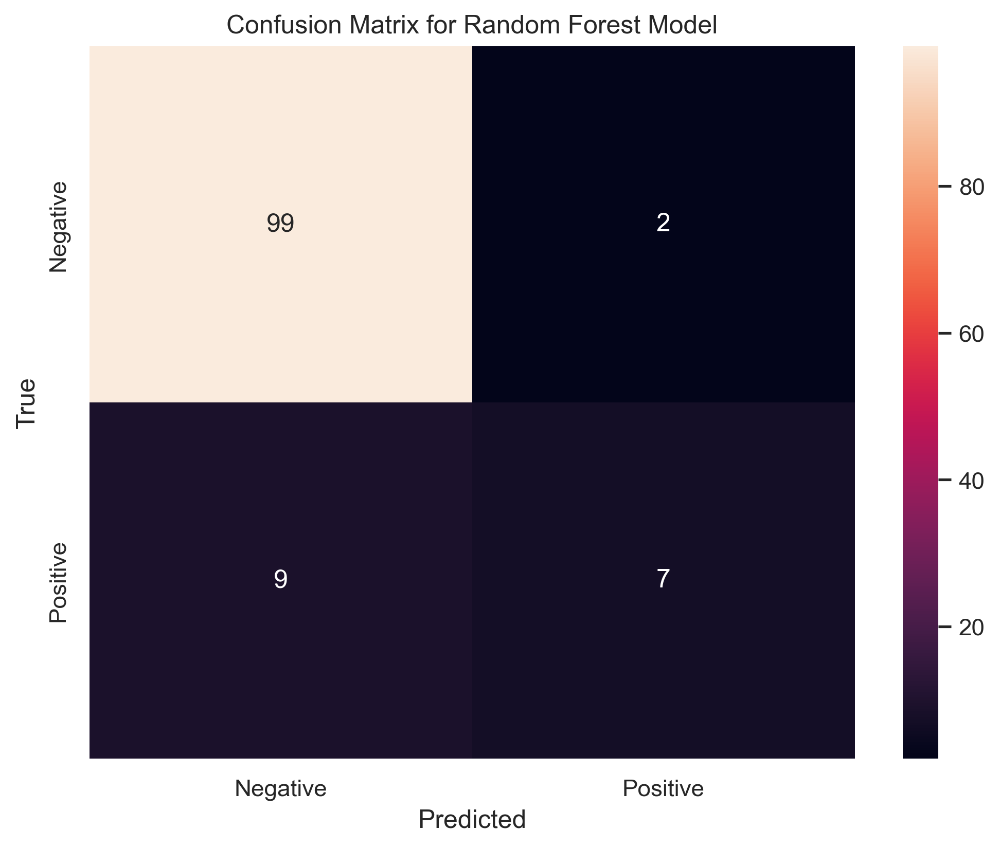

In [72]:
rf_preds_test = predict_rf(optimal_rf, class_X_test.to_numpy()) # make predictions on the test set
rf_preds_train = predict_rf(optimal_rf, class_X_train.to_numpy()) # make predictions on the training set
c_mat_rf = confusion_matrix(rf_preds_test, class_y_test.to_numpy()) # compute the confusion matrix
c_mat_df_rf = pd.DataFrame(c_mat_rf, index=["Negative", "Positive"], columns=["Negative", "Positive"])
sns.heatmap(c_mat_df_rf, annot=True);
plt.title('Confusion Matrix for Random Forest Model')
plt.xlabel("Predicted")
plt.ylabel("True")
plt.show()

We display the accuracy, precision and $F$-score for the predictions made by the optimal random forest:

In [73]:
print("In-sample accuracy = ", accuracy(rf_preds_train, class_y_train.to_numpy()))
print("In-sample precision = ", precision(rf_preds_train, class_y_train.to_numpy()))
print("In-sample F-score = ", F_score(rf_preds_train, class_y_train.to_numpy()))
print()
print("Out-of-sample accuracy = ", accuracy(rf_preds_test, class_y_test.to_numpy()))
print("Out-of-sample precision = ", precision(rf_preds_test, class_y_test.to_numpy()))
print("Out-of-sample F-score = ", F_score(rf_preds_test, class_y_test.to_numpy()))

In-sample accuracy =  0.9633699633699634
In-sample precision =  0.9722222222222222
In-sample F-score =  0.875

Out-of-sample accuracy =  0.905982905982906
Out-of-sample precision =  0.7777777777777778
Out-of-sample F-score =  0.56


In general, the metrics we have computed show that our optimal random forest is a good classifier for this task.

The optimal random forest has excellent accuracy, as it correctly classifies over $96\%$ and over $90\%$ of the in sample and out of sample data points into their correct classes, respectively. However, this measure is flawed as if a model correctly predicts the majority class but incorrectly predicts the minority class, and there is a great imbalance between the classes, the model will still yield a high accuracy whilst potentially misclassifying the minority class, which in this case is more important to correctly classify than the minority class, as it is more dangerous to incorrectly predict that a patient doesn't have diabetes when they do than to incorrectly predict that a patient has diabetes when they don't.

Moreover, it has an in sample F-score of over $87.5%$, which is excellent for a classifier as as F-score decreases sharply when misclassifications are made. However, this decreases to just over $56\%$ when we move out of sample, which still is a reasonable score, but this sharp drop in F-score suggests that this model might not generalise well when moving to unseen datapoints.


Lastly, the in-sample precision is also good at over $87\%$, but again it drops to just over $77\%$ when we move out of sample; this is good as in our case, precision is more important than accuracy as, like we stated before, we want our model to maximise the number of true positives, but as stated previously this sharp drop in precision raises concerns about the generalisation error of the model.

##### 2.1.3

We examine the imbalance in training samples for both classes by using pandas' `value_counts` method on the training labels:

In [74]:
class_y_train.value_counts()

0    229
1     44
Name: diabetes, dtype: int64

We can see there is a great imbalance between the classes; just under 85% of the data points are labelled as not having diabetes, which will implicitly bias any unweighted random forest we train to classify unseen points as not having diabetes. 

We attempt to fix this by adding weights to our random forest; as we want both classes to have approximately equal probabilities, and we have 2 classes, we define the following weights:

$$
w_0 = \frac{1}{(2|{\{\mathbf{x}:\text{No diabetes}\}}|)},w_1 = \frac{1}{(2|\{{\mathbf{x}:\text{Diabetes}}\}|)}
$$

Where ${\{\mathbf{x}:\text{No diabetes}\}}$ is the set of all training points that are labelled as not having diabetes, ${\{\mathbf{x}:\text{No diabetes}\}}$ is the set of all training points that are labelled as having diabetes and $|S|$ is the cardinality of set $S$. For our data, the weights are computed below:

In [75]:
weight_map = {0 : 1/(class_y_train.value_counts()[0]*2), 1 : 1/(class_y_train.value_counts()[1]*2)}
weights = class_y_train.map(weight_map).to_numpy()

We now recompute the optimal parameters for the weighed random forest model:

In [76]:
b_params_weighted = k_cross_validation_rf(class_X_train, class_y_train, [1, 5, 10, 20, 50], [1, 2, 3, 4, 5, 6, 7, 8, 9, 10], k=4, sample_weights=weights)

100%|██████████| 5/5 [02:15<00:00, 27.20s/it]


The optimal parameters for the weighted random forest are unpacked & displayed below:

In [77]:
best_B_weighted, best_max_depth_weighted = b_params_weighted
print("Best number of trees for the weighted model: {}".format(best_B_weighted))
print("Best max depth for the weighted model: {}".format(best_max_depth_weighted))

Best number of trees for the weighted model: 20
Best max depth for the weighted model: 9


We retrain our weighted random forest model using our optimal parameters found via 4-fold cross validation on the whole training set, using again $\lfloor \sqrt{D}\rfloor$ features.

In [78]:
nfeatures = int(np.sqrt(class_X_train.shape[1]))
optimal_rf_weighted = train_rf(best_B_weighted, nfeatures, class_X_train, class_y_train, columns_dict, max_depth=best_max_depth_weighted, sample_weights=weights)
rf_preds_weighted_train = predict_rf(optimal_rf_weighted, class_X_train.to_numpy()) # make predictions on the training set
rf_preds_weighted_test = predict_rf(optimal_rf_weighted, class_X_test.to_numpy()) # make predictions on the test set

Lastly, we compute the out-of-sample Accuracy, Precision and F-score for our weighted model.

In [79]:
print("In sample accuracy = ", accuracy(rf_preds_weighted_train, class_y_train.to_numpy()))
print("In sample precision = ", precision(rf_preds_weighted_train, class_y_train.to_numpy()))
print("In sample F-score = ", F_score(rf_preds_weighted_train, class_y_train.to_numpy()))
print()
print("Out of sample accuracy = ", accuracy(rf_preds_weighted_test, class_y_test.to_numpy()))
print("Out of sample precision = ", precision(rf_preds_weighted_test, class_y_test.to_numpy()))
print("Out of sample F-score = ", F_score(rf_preds_weighted_test, class_y_test.to_numpy()))

In sample accuracy =  0.9706959706959707
In sample precision =  0.8461538461538461
In sample F-score =  0.9166666666666666

Out of sample accuracy =  0.8974358974358975
Out of sample precision =  0.5833333333333334
Out of sample F-score =  0.7000000000000001


Once again, we see that the weighted random forest classifier performs better in sample than out of sample, and that the out of sample precision for the weighted random forest classifier is remarkably low in this instance. We now compare these metrics with the unweighted random forest classifier - we note that, in sample, the weighted random forest classifier outperforms the unweighted random forest classifier in all metrics except in precision, where the unweighted random forest classifier is more precise by $\approx 12.5$ percentage points, a significant difference. However, notice that the in sample accuracy for both classifiers is almost identical, and also that the F-scores are very close together.

When we move out of sample, it is worth noting the unweighted random forest classifier outperforms the weighted random forest classifier in all metrics but in F-score, where the weighted classifier comes performs $14%$ percentage points higher, a significant difference as the F-score is very sensitive to misclassifications. Nevertheless, as stated previously, the low out of sample precision score for the weighted random forest classifier is concerning; this might be due to bad luck when drawing samples from `np.random`.

Now, we implement a function to compute the false positive and true positive rates when the acceptance threshold is varied; the acceptance threshold $\tau$ defined as the minimal value used to label a point at $1$ or $0$, i.e. if $\mathbb{P}(\mathbf{x}\in\{\text{Diabetes}\})>\tau$, then we predict $\mathbf{x}\in\{\text{Diabetes}\}$. Varying the threshold $\tau$ produces the Receiver Operating Curve (ROC) for our model:

In [80]:
def roc_curve_rf(y_pred, y_true):
    """
    Compute the ROC curve of the random forest model.
    Args:
        y_true: (np.array) vector of true labels, of shape (N,).
        y_pred: (np.array) vector of predicted labels, of shape (N,).
        Returns:
        fpr: (np.array) vector of false positive rates, of shape (N,).
        tpr: (np.array) vector of true positive rates, of shape (N,).
    """
    fpr = []
    tpr = []
    for threshold in np.linspace(-0.01, 1.00, 101): # for it to connect to the origin
        y_pred_binary = np.where(y_pred > threshold, 1, 0) # convert the predictions to binary
        cm = confusion_matrix(y_pred_binary, y_true) # compute the confusion matrix
        tpr.append(cm[1, 1] / (cm[1, 1] + cm[1, 0])) # compute the true positive rate and append it to the list
        fpr.append(cm[0, 1] / (cm[0, 1] + cm[0, 0])) # compute the false positive rate and append it to the list
    return fpr, tpr

To apply this to our data, we first compute the probabilities that a datapoint $\mathbf{x}$ is classified as having diabetes, and we do this for all of our datapoints. Afterwards, we compute the FP and TP rates by varying the threshold $\tau$:

In [81]:
preds_prob_diabetes = predict_probabilities_rf(optimal_rf, class_X_test.to_numpy(), [0, 1])[:,1]
preds_prob_diabetes_weighted = predict_probabilities_rf(optimal_rf_weighted, class_X_test.to_numpy(), [0, 1])[:,1]
fpr_unweighted, tpr_unweighted = roc_curve_rf(preds_prob_diabetes, class_y_test.to_numpy())
fpr_weighted, tpr_weighted = roc_curve_rf(preds_prob_diabetes_weighted, class_y_test.to_numpy())

We now plot our ROC for the weighted and unweighted random forest models:

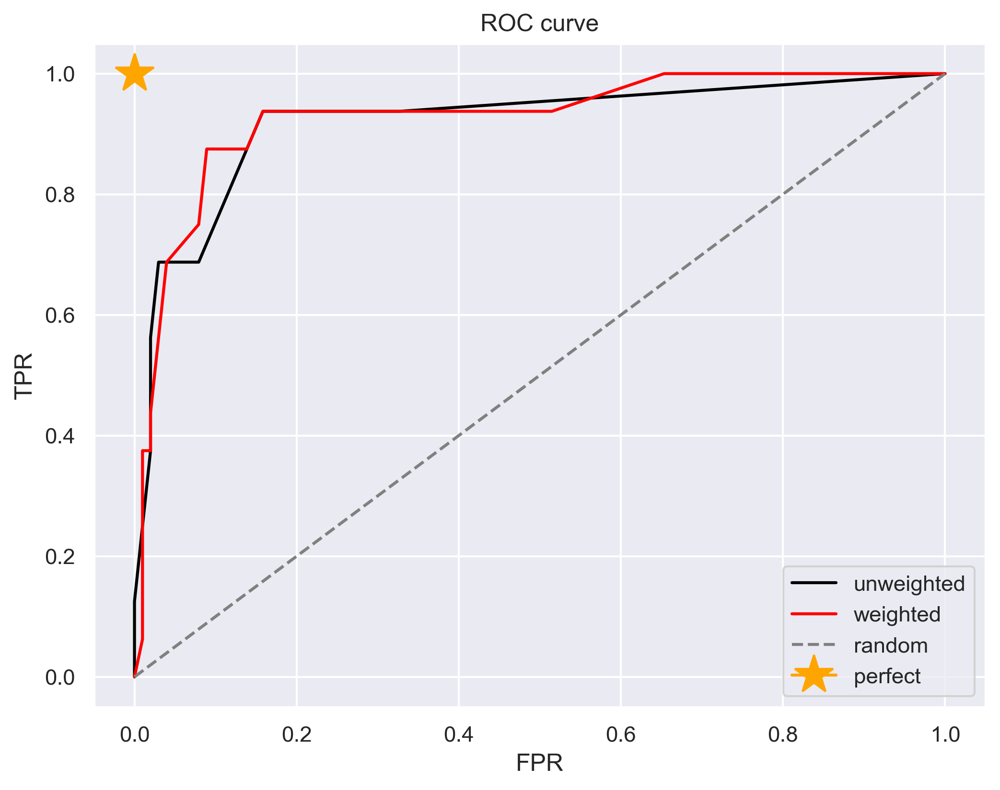

In [82]:
plt.plot(fpr_unweighted, tpr_unweighted, label="unweighted", color="black")
plt.plot(fpr_weighted, tpr_weighted, label="weighted", color="red")
plt.plot([0, 1], [0, 1], label="random", linestyle="--", color="grey")
plt.plot(0, 1, label="perfect", marker="*", markersize=20, color="orange")
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC curve")
plt.show()

We also display the AUCs of the weighted and unweighted models - we add the absolute value to take in account the area computed being negative due to `np.trapz`'s convention:

In [83]:
print("AUC weighted = ", np.abs(np.trapz(tpr_weighted, fpr_weighted)))
print("AUC unweighted = ", np.abs(np.trapz(tpr_unweighted, fpr_unweighted)))

AUC weighted =  0.9279084158415841
AUC unweighted =  0.9195544554455445


We see a small yet significant improvement when introducing weights into our random forest to compensate for the imbalance in classes; this can be observed in the ROC curve and the AUC values, where in the former it can be seen that the weighted random forest gets closer to the perfect classifier than the unweighted random forest, and in the latter it can be seen that the weighted random forest's AUC is slightly larger than the unweighted random forest's AUC, indicating that the weighted random forest preforms better as a classifier.

We now compute the precision-recall curve for the weighted & unweighted models, and display it below. As a reminder, the precision-recall curve operates similarly to the ROC; we vary the threshold $\tau$ such that $\mathbf{x}\in\{\text{Diabetes}\}$ means that we predict that $\mathbf{x}\in\{\text{Diabetes}\}$. With this, we compute the precision and recall for that $\tau$, and show how it varies as $\tau$ changes from $0$ to $1$.

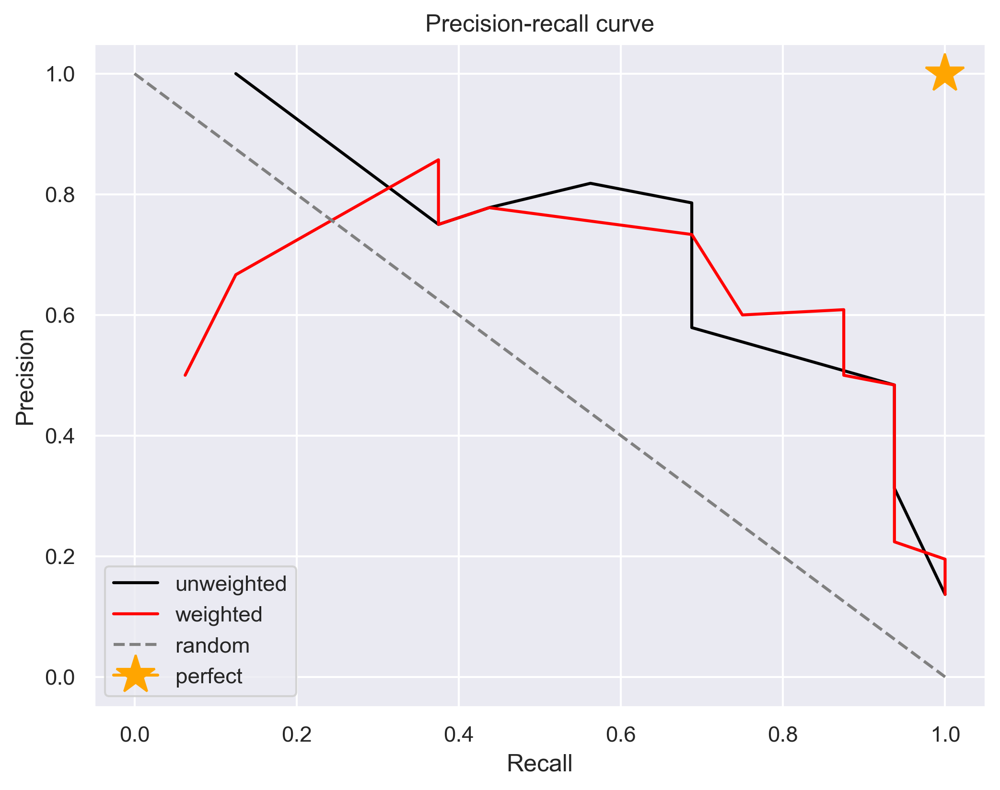

In [84]:
def precision_recall_rf(y_pred, y_true):
    """Compute the precision-recall curve of the random forest model. This should vary the threshold and append the true positive
    and false positive rates for that threshold into two arrays, tpr and fpr, and return them."""
    precision = []
    recall = []
    for threshold in np.linspace(0, 1.00, 101): 
        y_pred_binary = np.where(y_pred >= threshold, 1, 0) # convert the predictions to binary
        cm = confusion_matrix(y_pred_binary, y_true) # compute the confusion matrix
        if (cm[0, 1] + cm[1, 1] == 0 or cm[1, 1] + cm[1, 0] == 0): # if the denominator is 0, append None
            precision.append(None)
            recall.append(None)
            continue
        # compute the precision and recall for that threshold
        pr_thresh = cm[1, 1] / (cm[1, 1] + cm[0, 1])
        recall_thresh = cm[1, 1] / (cm[1, 1] + cm[1, 0])
        # append the precision and recall to the list
        precision.append(pr_thresh)
        recall.append(recall_thresh)
    return precision, recall

precision_unweighted, recall_unweighted = precision_recall_rf(preds_prob_diabetes, class_y_test.to_numpy())
precision_weighted, recall_weighted = precision_recall_rf(preds_prob_diabetes_weighted, class_y_test.to_numpy())

plt.plot(recall_unweighted, precision_unweighted, label="unweighted", color="black")
plt.plot(recall_weighted, precision_weighted, label="weighted", color="red")
plt.plot([0, 1], [1, 0], label="random", linestyle="--", color="grey")
plt.plot(1, 1, label="perfect", marker="*", markersize=20, color="orange")
plt.legend()
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-recall curve")
plt.show()


Again, we can see that the weighted random forest outperforms the unweighted random forest, as it gets closer to the perfect classifier in the precision-recall curve. However, the weighted random forest's performance decreases more sharply than the unweighted random forest's ones, and at one point it performs worse than random, meaning its performance is highly sensitive to changes in the threshold $\tau$.

#### 2.2	Support Vector Machine (SVM) (30 marks)

##### 2.2.1

We start by giving a brief reminder of SVM; SVM works by finding the hyperplane that accurately separates (i.e. correctly classifies into two categories) the most points possible with the highest margin, i.e. the separating hyperplane that is furthest apart from the closest datapoints; these are called the support vectors. In this case, we are using soft-margin SVM, meaning we add a term that allows some of the datapoints to be misclassified to attempt to reduce the generalisation (out-of-sample) error.


We have the following loss function for the soft margin SVM:

$$
\frac{1}{2}\|\mathbf{w}\|^2_2 +\lambda\sum_{i=1}^N\max\left\{0,1-y^i(\mathbf{x}^i\cdot \mathbf{w} + b)\right\}
$$

We start by augmenting the data matrix $\mathbf{X}$, this time by adding a column of $1$ s to the right to account for the intercept $b$, as seen in the lectures. Moreover, we map the $0,1$ values we assigned to the $\text{No Diabetes}, \text{Diabetes}$ classes to $-1,1$ in order to easily use SVM to separate the data.

In [85]:
class_X_train_intercept = np.hstack([class_X_train, np.ones((len(class_X_train),1))])
class_X_test_intercept = np.hstack([class_X_test, np.ones((len(class_X_test),1))])
class_y_train_svm = (2*class_y_train-1).to_numpy().astype(float)
class_y_test_svm = (2*class_y_test-1).to_numpy().astype(float)

We now implement functions to compute the cost and the gradient of the cost at a given $(\mathbf{w},\mathbf{X},\mathbf{y},\lambda)$:

In [86]:
def compute_cost(w, X, y, regul_strength=1e5):
  """
  Compute the cost function for the SVM model.
    Args:
        w: (np.array) vector of weights, of shape (D,).
        X: (np.array) matrix of features, of shape (N, D).
        y: (np.array) vector of labels, of shape (N,).
        regul_strength: (float) regularization strength.
    Returns:
        cost: (float) the cost of the SVM model.
  """
  distances = 1 - y * (X @ w)  # compute the distances
  distances[distances < 0] = 0  # take the max of 0 and the distance
  hinge = regul_strength * distances.sum() # compute the hinge loss
    
  return 0.5 * np.dot(w, w) + hinge

def calculate_cost_gradient(w, X_batch, y_batch, regul_strength=1e6):
    """
    Compute the gradient of the cost function for the SVM model.
    Args:
        w: (np.array) vector of weights, of shape (D,).
        X_batch: (np.array) matrix of features, of shape (N, D).
        y_batch: (np.array) vector of labels, of shape (N,).
        regul_strength: (float) regularization strength.
    Returns:
        dw: (np.array) the gradient of the cost with respect to w, of shape (D,).
    """
    if type(y_batch) == np.float64: # if the batch is a single sample, convert it to an array
        y_batch = np.asarray([y_batch])
        X_batch = np.asarray([X_batch])

    distance = 1 - (y_batch * (X_batch @ w)) # compute the distances
    dw = np.zeros(len(w)) # initialise the gradient

    we = w.copy() # copy the weights
    we[-1] = 0 # set the intercept to 0

    for ind, d in enumerate(distance):
        if max(0, d)==0:
            di = we # derivative if second term is 0
        else:
            di = we - (regul_strength * y_batch[ind] * X_batch[ind]) # derivative if second term is not 0
        dw += di

    return dw/len(y_batch) # return the average gradient

We now implement Stochastic Gradient Descent with consecutive loss approximation and max iteration stopping criterion, which works as follows: Let $L_i$ be the cost computed at iteration $i$, $\mathbf{x}_i$ be the value of $\mathbf{x}$ after $i$ iterations of SGD, and fix a stopping threshold $\varepsilon$ and a max number of iterations `max_iter`. Then at a given iteration $i$, SGD will check if one of the following conditions is met:

* If $i = 2^n$ for some $n$, check if $|L_i - L_{i-1}|<\varepsilon L_{i-1}$
* $i>$ `max_iter`

If one of these criteria is met, SGD will stop and return $\mathbf{x}_i$,

In [87]:
def sgd(X, y, max_iterations=2000, stop_criterion=0.001, learning_rate=1e-5, regul_strength=1e6, print_outcome=False):
  """
  Perform stochastic gradient descent to learn the weights of the SVM model.
  Args:
      X: (np.array) matrix of features, of shape (N, D).
      y: (np.array) vector of labels, of shape (N,).
      max_iterations: (int) maximum number of iterations to run the algorithm for.
      stop_criterion: (float) the algorithm will stop if the difference in cost between two iterations is less than this.
      learning_rate: (float) the learning rate for the gradient descent.
      regul_strength: (float) regularization strength.
      print_outcome: (bool) whether to print the cost at each iteration.
  Returns:
      weights: (np.array) vector of weights, of shape (D,).
  """
  weights = np.zeros(X.shape[1]) # initialise the weights
  nth = 0 # counter for convergence check
  prev_cost = np.inf # initialise the previous cost to infinity
  
  indices = np.arange(len(y)) # indices for shuffling

  for iteration in range(1, max_iterations):
    np.random.shuffle(indices)
    X, y = X[indices], y[indices] # shuffle the data to prevent cycles
    
    for xi, yi in zip(X, y):
      descent = calculate_cost_gradient(weights, xi, yi, regul_strength) # compute the gradient
      weights = weights - (learning_rate * descent) # update the weights

    if iteration==2**nth or iteration==max_iterations-1: # check for convergence every 2^n iterations
      cost = compute_cost(weights, X, y, regul_strength) # compute the cost
      if print_outcome:
        # if print_outcome is True, print the cost at each iteration
        print("Iteration is: {}, Cost is: {}".format(iteration, cost))
      if abs(prev_cost - cost) < stop_criterion * prev_cost:
        # if the cost has not changed significantly, stop the algorithm
        return weights
        
      prev_cost = cost # update the previous cost
      nth += 1 # update the counter
  
  return weights

def score(w, X, y):
  """
  Compute the accuracy of the SVM model.
  Args:
      w: (np.array) vector of weights, of shape (D,).
      X: (np.array) matrix of features, of shape (N, D).
      y: (np.array) vector of labels, of shape (N,).
  Returns:
      accuracy: (float) the accuracy of the SVM model.
  """
  y_preds = np.sign(X @ w) # predictions
  return np.mean(y_preds == y) # accuracy

We now implement k-fold cross-validation for SVM to find the optimal hardness parameter $\lambda$:

In [88]:
def k_cross_validation_svm(X, y, lambdas, k, maxiter=2_000, stop_criterion=0.001, learning_rate=1e-5, print_outcome=False):
    """
    Performs k-fold cross validation for a given set of lambdas.
    Returns the best lambda and the corresponding score.
    Args:
        X (np.array): data matrix
        y (np.array): labels
        lambdas (list): list of lambdas to try
        k (int): number of folds
        maxiter (int): maximum number of iterations for SGD
        stop_criterion (float): stop criterion for SGD
        learning_rate (float): learning rate for SGD
        print_outcome (bool): whether to print the outcome of each iteration
    Returns:
        best_lambda (float): best lambda
        ovr_scores (float): overall scores for each lambda
    """
    # split the data into k folds
    X_folds = np.array_split(X, k)
    y_folds = np.array_split(y, k)
    best_score = 0 # initialise the best score to 0
    best_lambda = None # initialise the best lambda to None
    ovr_scores = [] # initialise the overall scores
    for lam in tqdm(lambdas):
        scores = [] # initialise the scores for this lambda
        for i in range(k):
            # split the data into training and test sets
            X_train_fold = np.concatenate(X_folds[:i] + X_folds[i+1:])
            y_train_fold = np.concatenate(y_folds[:i] + y_folds[i+1:])
            X_test_fold = X_folds[i]
            y_test_fold = y_folds[i]
            # train the model
            w = sgd(X_train_fold, y_train_fold, max_iterations=maxiter, stop_criterion=stop_criterion, learning_rate=learning_rate, regul_strength=lam, print_outcome=print_outcome)
            scores.append(score(w, X_test_fold, y_test_fold)) # compute the score
        score_lam = np.mean(scores) # compute the mean score for this lambda
        ovr_scores.append(np.array([lam, score_lam])) # append the score to the overall scores
        if score_lam > best_score: # if the score is better than the best score, update the best score and the best lambda
            best_score = score_lam
            best_lambda = lam
    return best_lambda, np.asarray(ovr_scores) # return the best lambda and the overall scores

We perform an initial scan to find out our optimal hardness parameter's order of magnitude is:

In [89]:
_, intial_svm_scores = k_cross_validation_svm(class_X_train_intercept, class_y_train_svm, [1e-2,1e-1,1, 1e1,1e2,1e3,1e4], 4)

100%|██████████| 7/7 [01:20<00:00, 11.52s/it]


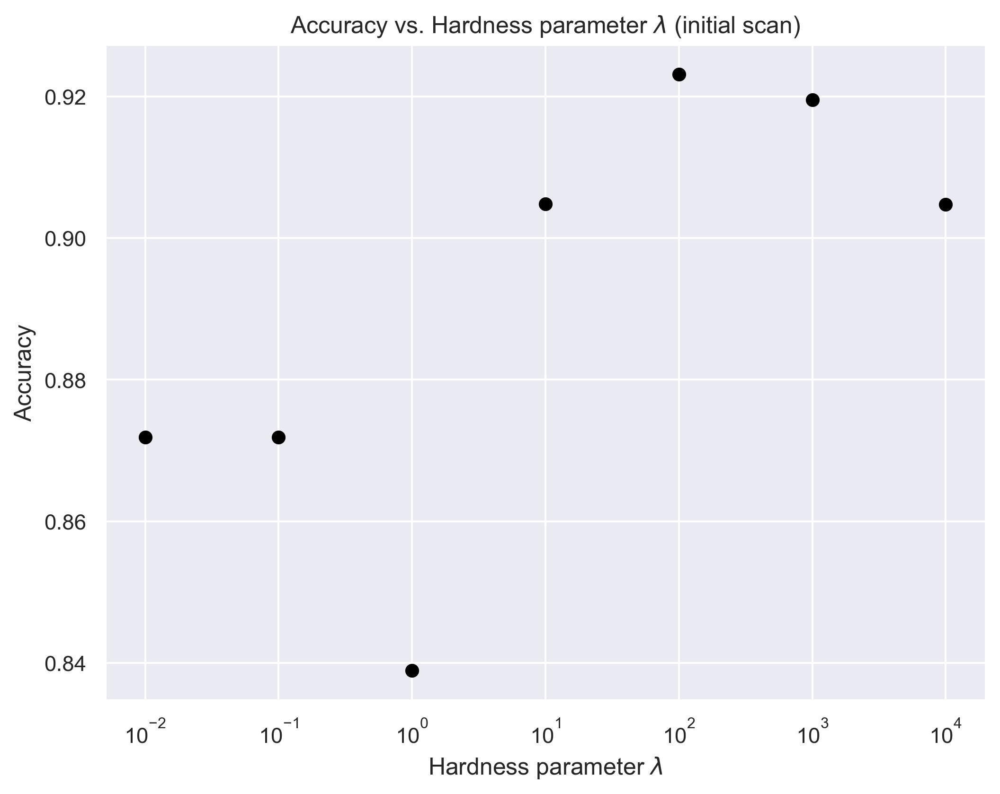

In [90]:
plt.scatter(intial_svm_scores[:,0], intial_svm_scores[:,1], color="black")
plt.xscale('log')
plt.xlabel('Hardness parameter $\lambda$')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Hardness parameter $\lambda$ (initial scan)')
plt.show()

From this, we can see that our optimal hardness parameter is somewhere in $[1,1000]$, as when the hardness is very low, the accuracy decreases from its highest value (in this rough scale) of $92\%$ to around $87\%$, and when the hardness is very high, it again decreases to just over $90\%$.

We now search for the optimal hardness parameter, $\lambda^*$, in the interval $[1,1000]$ by scanning $21$ equally spaced points between $1$ and $1000$:

In [91]:
best_lambda_svm, svm_scores = k_cross_validation_svm(class_X_train_intercept, class_y_train_svm, np.linspace(1,1000,21), 4)

100%|██████████| 21/21 [06:20<00:00, 18.11s/it]


And we print our optimal hardness parameter.

In [92]:
print("Best hardness parameter is: {}".format(best_lambda_svm))

Best hardness parameter is: 50.95


We now visualise how the accuracy changes as we vary the hardness parameter $\lambda$; in this case we chose to vary $\lambda$ from $1$ to $1000$:

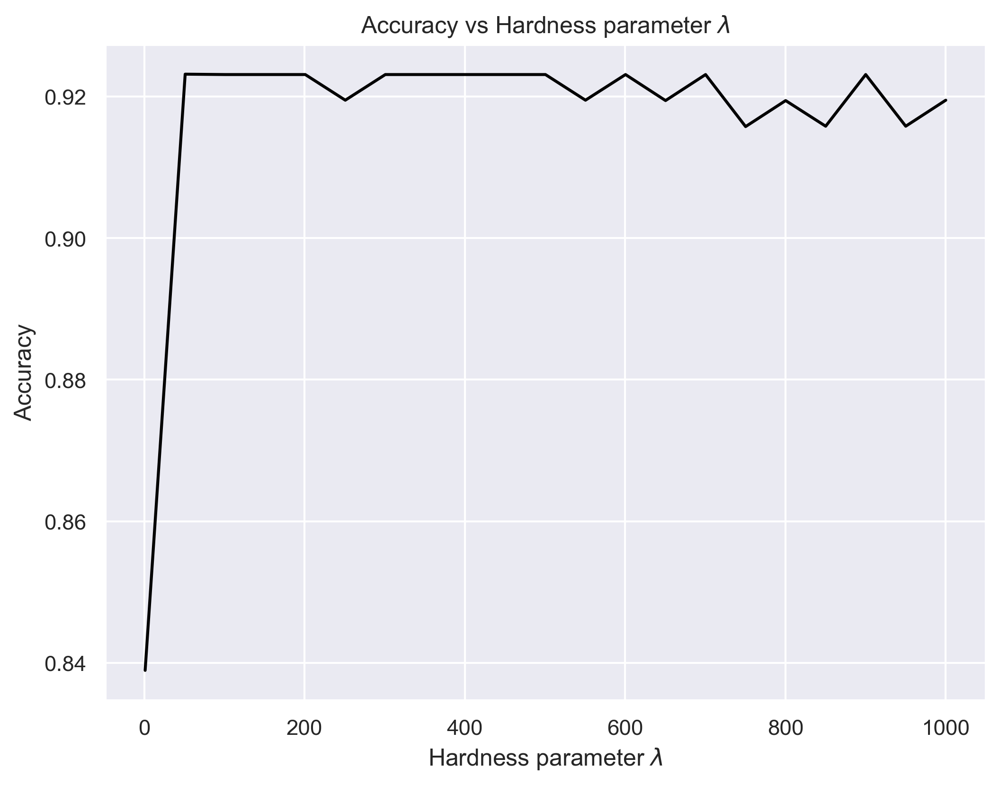

In [93]:
plt.plot(svm_scores[:,0], svm_scores[:,1], color="black")
plt.title("Accuracy vs Hardness parameter $\lambda$")
plt.xlabel("Hardness parameter $\lambda$")
plt.ylabel("Accuracy")
plt.show()

We display t `svm_scores` to examine how accuracy evolves when $\lambda$ is varied:

In [111]:
pd.DataFrame(svm_scores, columns=["Hardness parameter lambda", "Accuracy"])

,Hardness parameter lambda,Accuracy
0,1.00,0.838928
1,50.95,0.923167
2,100.90,0.923114
3,150.85,0.923114
4,200.80,0.923114
5,250.75,0.919491
6,300.70,0.923114
7,350.65,0.923114
8,400.60,0.923114
9,450.55,0.923114


We can see that after $\lambda$ reaches $\approx50$, the accuracy of the soft-margin SVM stabilises at around $92\%$. This is observed in the graph, as we can see the accuracies of the soft-margin SVM classifiers with hardness parameter $\lambda \geq 50$ fluctuate around $91\%\sim 92\%$.

##### 2.2.2

We now compute the hyperplanes for our range of $\lambda$ s:

In [94]:
hyperplanes = [sgd(class_X_train_intercept, class_y_train_svm, max_iterations=2000, stop_criterion=0.001, learning_rate=1e-5, regul_strength=lam, print_outcome=False) for lam in tqdm(np.linspace(1,100,21))]

100%|██████████| 21/21 [02:20<00:00,  6.69s/it]


We now define a function to compute the cosine of angle between two hyperplanes, and use this to compute the cosine of the angles between all of the hyperplanes:

In [95]:
def compute_angle(x, y):
    """
    Compute cosine of the angle between two vectors
    Args:
        x: (np.array) vector of shape (D,).
        y: (np.array) vector of shape (D,).
        Returns:
        angle: (float) cosine of the angle between x and y.
    """
    return np.dot(x, y) / (np.linalg.norm(x,2) * np.linalg.norm(y,2))

"""Compute angles between all pairs of hyperplanes"""
angles = np.zeros((len(hyperplanes), len(hyperplanes))) # initialise the matrix of angles
for i in range(len(hyperplanes)):
    for j in range(len(hyperplanes)):
        # compute the angle between the i-th and j-th hyperplanes using the dot product
        angles[i,j] = compute_angle(hyperplanes[i], hyperplanes[j])

Lastly, we produce a heatmap of the angles between the planes:

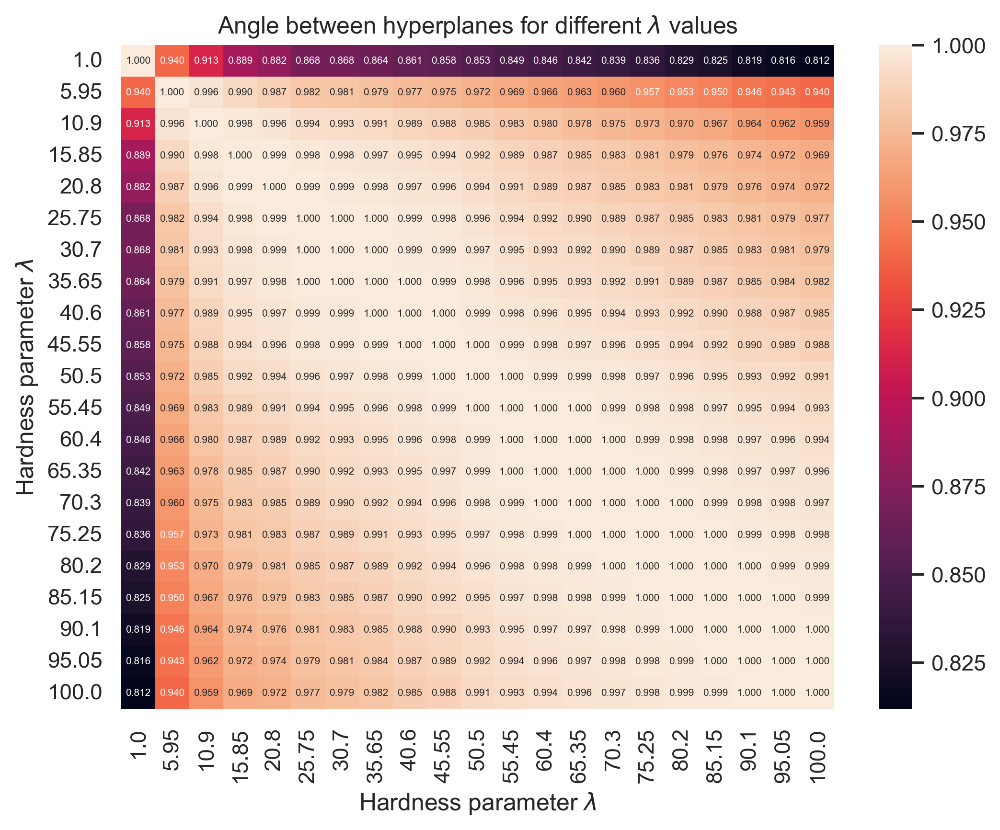

In [96]:
angles_df = pd.DataFrame(angles, columns=np.round(np.linspace(1,100,21),3), index=np.round(np.linspace(1,100,21),3))

sns.heatmap(angles_df, annot=True, fmt=".3f", annot_kws={"fontsize":5});
plt.figsize = (15,15)
plt.title("Angle between hyperplanes for different $\lambda$ values")
plt.xlabel("Hardness parameter $\lambda$")
plt.ylabel("Hardness parameter $\lambda$")
plt.show()

This heatmap coincides with our observed results when we varied the hardness parameter $\lambda$ - we can see that after a certain point, the cosine of the angles between the hyperplanes stays practically constant, varying by only $\approx 10^{-3}$ - this suggests that after a certain threshold hardness parameter $\lambda$, all of the hyperplanes are essentially the same, which agrees with our observation that after a certain threshold hardness parameter, the accuracy of our soft-margin SVM classifier varies minimally.

##### 2.2.3

We now compute the optimal hyperplane corresponding to our optimal hardness parameter, and measure how well it performs at correctly classifying the data:

In [97]:
optimal_w = sgd(class_X_train_intercept, class_y_train_svm, max_iterations=2000, stop_criterion=0.0001, learning_rate=1e-6, regul_strength=best_lambda_svm, print_outcome=False)

Again, we implement functions to analyse the performance of our SVM model against the true labels; this time we implement the precision, the accuracy and the F-score.

In [98]:
def predict_y_svm(w, X):
    """
    Compute predictions of the SVM model.
    Args:
        w: (np.array) vector of shape (D,).
        X: (np.array) matrix of features, of shape (N, D).
        y: (np.array) vector of labels, of shape (N,).
    Returns:
        y_preds: (np.array) vector of predictions, of shape (N,).
    """
    y_preds = np.sign(X @ w)
    return y_preds.astype(int)

We now use these functions to compute the out-of-sample precision, accuracy and F-score for our model:

In [99]:
y_preds_SVM = predict_y_svm(optimal_w, class_X_test_intercept)
precision_svm = precision(y_preds_SVM, class_y_test_svm.astype(int))
accuracy_svm = accuracy(y_preds_SVM, class_y_test_svm.astype(int))
F_score_svm = F_score(y_preds_SVM, class_y_test_svm.astype(int))

In [100]:
print("Out of sample accuracy: {}".format(accuracy_svm))
print("Out of sample precision: {}".format(precision_svm))
print("Out of sample F-score: {}".format(F_score_svm))

Out of sample accuracy: 0.9316239316239316
Out of sample precision: 0.8333333333333334
Out of sample F-score: 0.7142857142857143


From these metrics, we can see that the performance of the soft-margin SVM classifier is similar to that of the random forest classifier, as all of its statistics are similar (in fact, soft-margin SVM manages to outperform random forests forests in accuracy and, most importantly, precision) and therefore the same conclusions apply:

The soft-margin SVM has great accuracy, as it correctly classifying over $93\%$ of the out of sample data points into their correct classes. We note that this is slightly higher than the both the weighted and unweighted random forest classifier's accuracy. However, this measure is flawed as if a model correctly predicts the majority class but incorrectly predicts the minority class, and there is a great imbalance between the classes, the model will still yield a high accuracy whilst potentially misclassifying the minority class, which in this case is more important to correctly classify than the minority class, as it is more dangerous to incorrectly predict that a patient doesn't have diabetes when they do than to incorrectly predict that a patient has diabetes when they don't.

Moreover, it boasts an out of sample F-score of $71\%$, which a good score, as F-score sharply decreases when misclassifications occur. Once again, this is higher than the weighted & unweighted random forest classifier's F-score, suggesting that the soft-margin SVM classifier might be more prone to misclassifying predictors than the random forest classifier.

Lastly, the out of sample precision is excellent at over $83\%$; this is notably better than the random forest classifier's $\approx 77%$ and $\approx 58\%$ precisions for the unweighted and weighted versions of the classifier. This is good news as in our data precision is more important than accuracy because we want our model to maximise the number of true positives.

As the soft-margin SVM classifier and the random forest classifier both have similar performance, it might be more suitable to use the soft-margin SVM classifier for classification as it only relies on one hyperparameter, the hardness parameter $\lambda$ as opposed to the random forest classifier's two hyperparameters, `B`, the number of trees, and `max_depth`, the maximum depth of the trees, meaning one does not have to perform grid search for the optimal hyperparameters, making cross-validation less computationally expensive and hyperparameter tuning more accurate as the hyperparameter search space is reduced.

##### 2.2.4

We are asked to implement a kernelised soft-margin SVM by minimising:

$$
L(\mathbf{u},\,b) = \frac{1}{2}\mathbf{u}^\top\mathbf{K}\mathbf{u} + \lambda\sum_{i=1}^N \max\left\{0,1-y^{(i)}\left(\mathbf{K}^{(i)}\mathbf{u} + b\right)\right\}
$$

Where the kernel is the sigmoid kernel:
$$
[\mathbf{K}]_{i,j} = \tanh(\sigma(\mathbf{x}^{(i)}\cdot \mathbf{x}^{(j)}) + 1)
$$

In [101]:
def kernel_matrix(X1,X2,sigma):
    """
    Compute the kernel matrix between two data matrices.
    Args:
        X1: (np.array) matrix of data points, of shape (N1, D).
        X2: (np.array) matrix of data points, of shape (N2, D).
        sigma: (float) the kernel parameter.
    Returns:
        kernel: (np.array) the kernel matrix, of shape (N1, N2).
    """
    n1, _ = X1.shape
    n2, _ = X2.shape
    kernel = np.zeros((n1,n2)) # initialise the kernel matrix

    for i in range(n1):
        kernel[i,:] = np.tanh(sigma*np.dot(X2,X1[i])+1) # compute the sigmoid kernel between the i-th row of X1 and X2
        
    return kernel

We now implement computing the cost for a given $(\mathbf{u}, b)$:

In [102]:
def compute_cost_kernel(u, K, y, regul_strength=1e3, intercept=0):
    """
    Compute the cost of the soft-margin kernelised SVM model.
    Args:
        u: (np.array) vector of shape (N,).
        K: (np.array) kernel matrix, of shape (N, N).
        y: (np.array) vector of labels, of shape (N,).
        regul_strength: (float) the regularization strength.
        intercept: (float) the intercept.
    Returns:
        cost: (float) the cost of the soft-margin sigmoid kernelised SVM model.
    """
    distances = 1 - (y)*(K@u + intercept) # compute the distances between the hyperplane and the data points
    distances[distances < 0] = 0 # take the max between 0 and the distances
    hinge = regul_strength * np.sum(distances) # compute the hinge loss

    return 0.5 * np.dot(u,K@u) + hinge

And we implement computing the gradient of the cost w.r.t. $\mathbf{u}$:

In [103]:
def calculate_cost_gradient_kernel(u, K_batch, y_batch, regul_strength=1e3,intercept=0):
    """
    Compute the gradient of the cost of the soft-margin kernelised SVM model.
    Args:
        u: (np.array) vector of shape (N,).
        K_batch: (np.array) kernel matrix, of shape (N, N).
        y_batch: (np.array) vector of labels, of shape (N,).
        regul_strength: (float) the regularization strength.
        intercept: (float) the intercept.
    Returns:
        dw: (np.array) the gradient of the cost, of shape (N,).
    """
    if type(y_batch) == np.float64 or type(y_batch) == np.int32: # if y_batch is a scalar, convert it to a vector
        y_batch = np.asarray([y_batch])
        K_batch = np.asarray([K_batch])
    
    # compute the distances between the hyperplane and the data points
    distance = 1 - (y_batch * (K_batch @ u + intercept)) 
    # initialise the gradient
    dw = np.zeros(len(u))

    for ind, d in enumerate(distance):
        if max(0, d)==0:
            di = K_batch@u # gradient when the distance is less than 0
        else:
            di = K_batch@u - (regul_strength * y_batch[ind] * K_batch[ind]) # gradient when the distance is greater than 0
        dw += di

    return dw/len(y_batch)

Note that now, we cannot use the same trick of augmenting the data matrix $\mathbf{X}$ by adding a column of ones to the left, as we need the kernel matrix to have a column of ones, as opposed to the $\mathbf{X}$. Therefore, we also implement a function to compute the gradient w.r.t. the intercept $b$, as we will perform gradient descent on both $\mathbf{u}$ and $b$ to optimise their values:

In [104]:
def calculate_cost_gradient_intercept_kernel(u, K_batch, y_batch, regul_strength=1e3,intercept=0):
    
    """
    Compute the gradient of the cost of the soft-margin kernelised SVM model.
    Args:
        u: (np.array) vector of shape (N,).
        K_batch: (np.array) kernel matrix, of shape (N, N).
        y_batch: (np.array) vector of labels, of shape (N,).
        regul_strength: (float) the regularization strength.
        intercept: (float) the intercept.
    Returns:
        db: (np.array) the gradient of the cost, of shape (N,).
    """
        
    if type(y_batch) == np.float64 or type(y_batch) == np.int32:
        y_batch = np.asarray([y_batch])
        K_batch = np.asarray([K_batch])
    
    db = 0 # initialise the gradient
    # compute the distances between the hyperplane and the data points
    distance = 1 - (y_batch * (K_batch @ u + intercept))
    for ind, d in enumerate(distance):
        if max(0, d) != 0:
            db -= regul_strength*y_batch[ind] # gradient when the distance is greater than 0
    return db/len(y_batch)


In [105]:
def sgd_kernel(K, y, batch_size=32, max_iterations=4000, stop_criterion=0.001, learning_rate=1e-4, regul_strength=1e3, print_outcome=False):

    # initialise zero u and intercept
    u = np.zeros(K.shape[1])
    intercept=0 
    
    nth = 0
    # initialise starting cost as infinity
    prev_cost = np.inf
    
    indices = np.arange(len(y)) # indices of the data points
    for iteration in range(1, max_iterations):
        np.random.shuffle(indices) # shuffle the indices to prevent cycles
        batch_idx = indices[:batch_size] # select a batch of indices
        K_b, y_b = K[batch_idx], y[batch_idx] # select the corresponding data points
        for ki, yi in zip(K_b, y_b):
            # compute the gradient
            ascent_u = calculate_cost_gradient_kernel(u, ki, yi, regul_strength, intercept) 
            ascent_intercept = calculate_cost_gradient_intercept_kernel(u, ki, yi, regul_strength, intercept)
            # update u and intercept
            u = u - (learning_rate * ascent_u)
            intercept = intercept - (learning_rate * ascent_intercept)
        
        # check if the iteration is a power of 2 or penultimate iteration
        if iteration==2**nth or iteration==max_iterations-1: 
            # compute cost
            cost = compute_cost_kernel(u, K, y, regul_strength, intercept)
            if print_outcome:
                # if print_outcome is True, print the iteration and cost
                print("Iteration is: {}, Cost is: {}".format(iteration, cost))
            if abs(prev_cost - cost) < stop_criterion * prev_cost: 
                # if the cost has not changed much, stop the algorithm
                return u, intercept
            
            prev_cost = cost # update the previous cost
            nth += 1 # update the power of 2
    
    return u, intercept

We now apply this to our data and to $\sigma = 0.01, 0.1, 1, 2$ to compute the optimal hyperplanes for the sigmoid-kernelised soft-margin SVM. After each value of $\sigma$ has finished running, we display the intercept $b$ obtained for said $\sigma$:

In [106]:
kernel_us = []
kernel_intercepts = []
sigmas = [0.01,0.1,1,2]

for sigma in sigmas:
    K_train = kernel_matrix(class_X_train.to_numpy(),class_X_train.to_numpy(), sigma)
    u,b = sgd_kernel(K_train, class_y_train_svm, batch_size=32, max_iterations=10_000, stop_criterion=1e-4, learning_rate=1e-5, regul_strength=10, print_outcome=False)
    u = np.reshape(u,(len(u),1))
    kernel_us.append(u)
    kernel_intercepts.append(b)
    print('For sigma = ' + str(sigma) + ", b is {}".format(b))
    print("\n")

For sigma = 0.01, b is -0.19739999999999458


For sigma = 0.1, b is -1.1426999999998906


For sigma = 1, b is -1.5767999999998428


For sigma = 2, b is -1.5099999999998501




##### 2.2.5

Finally, we are tasked to evaluate the precision, accuracy and F-score for the sigmoid-kernelised soft-margin SVM classifier and to compare it to the non-kernelised soft-margin SVM classifier. We first implement functions to evaluate the precision, given a set of predictions; note that in this case we are returning `"No information"` in case $TP + FP = 0$ or $TP + FN = 0$ in the precision and recall scores, respectively.

We now implement a function to predict the labels of a dataset given SVM weights \mathbf{u}, data matrix $\mathbf{X}$, kernel parameter $\sigma$ and SVM intercept $b$.

Furthermore, we implement functions to score these predictions using the precision, accuracy and F-scores.

In [107]:
def predict_y_kernel_SVM(u, X, sigma, intercept):
    """
    Predict the labels of the data X using the kernel SVM with weights u, intercept b and kernel
    K.
    Args:
        u (np.array): The weights of the SVM.
        X (np.array): The data to predict the labels for.
        sigma (float): The sigma parameter of the kernel.
        intercept (float): The intercept of the SVM.
    Returns:
        np.array: The predicted labels of the data X.
    """
    K_test = kernel_matrix(X, class_X_train.to_numpy(), sigma) # compute the kernel matrix
    y_preds = np.sign(K_test@u + intercept) # compute the predictions
    return y_preds.squeeze().astype(int) # return the predictions


Lastly, we loop over our values of $\sigma$ and compute the accuracy, precision and F-score to later display them:

In [108]:
stats_per_sigma = {}

for u, intercept, sigma in zip(kernel_us, kernel_intercepts, sigmas):
    y_preds_SVM_kernel = predict_y_kernel_SVM(u, class_X_test.to_numpy(), sigma, intercept)
    acc_sigma = accuracy(y_preds_SVM_kernel, class_y_test_svm.astype(int))
    prec_sigma = precision(y_preds_SVM_kernel, class_y_test_svm.astype(int))
    F_sigma = F_score(y_preds_SVM_kernel, class_y_test_svm.astype(int))
    stats_per_sigma[sigma] = {"Accuracy": acc_sigma, "Precision": prec_sigma, "F score": F_sigma}

for i in range(len(sigmas)):
    print("For sigma = " + str(sigmas[i]) + ", the accuracy is: " + str(stats_per_sigma[sigmas[i]]["Accuracy"]))
    print("For sigma = " + str(sigmas[i]) + ", the precision is: " + str(stats_per_sigma[sigmas[i]]["Precision"]))
    print("For sigma = " + str(sigmas[i]) + ", the F-score is: " + str(stats_per_sigma[sigmas[i]]["F score"]))
    print()

For sigma = 0.01, the accuracy is: 0.8632478632478633
For sigma = 0.01, the precision is: No information
For sigma = 0.01, the F-score is: No information

For sigma = 0.1, the accuracy is: 0.9316239316239316
For sigma = 0.1, the precision is: 0.8333333333333334
For sigma = 0.1, the F-score is: 0.7142857142857143

For sigma = 1, the accuracy is: 0.9145299145299145
For sigma = 1, the precision is: 0.6875
For sigma = 1, the F-score is: 0.6875

For sigma = 2, the accuracy is: 0.8803418803418803
For sigma = 2, the precision is: 0.55
For sigma = 2, the F-score is: 0.6111111111111112



Comparing the  can see that the best $\sigma$ to use in the kernelised soft-margin SVM classifier, denoted as $\sigma^*$, is $\sigma=0.1$, as it maximises the out of sample accuracy and precision. However, the F-score is maximised by $\sigma=1$, albeit both F-scores for $\sigma=0.1,1$ are very similar. 

Comparing the results obtained for $\sigma=\sigma^*$, we note that the linear soft-margin SVM classifier outperforms the kernelised soft-margin SVM classifier in all metrics for all values of $\sigma$ tested; this tells us that the chosen nonlinear function in the kernel, the sigmoid function, fits the data worse than a linear model, suggesting that it is possible that the underlying features are linearly related. However, it may also be the case that the features follow some nonlinear relation, and as the sigmoid kernel is similar to a linear function, the nonlinearity of the true underlying nonlinear relation cannot be captured by a "not-very-nonlinear" nonlinear function such as the sigmoid kernel.

Lastly, a larger range of $\sigma$ should be scanned in order to further optimise the performance of the kernelised SVM, as using $4$ values of $\sigma$ may not be enough to be near the optimal value of $\sigma$ that maximises the performance of the kernelised soft-margin SVM classifier. Furthermore, SGD's hyperparameters such as `learning_rate`, `stop_criterion`, `max_iterations` and `batch_size` may also be tuned to obtain faster & more accurate SGD convergence, which may lead to better results in shorter time, making the scanning of a larger range of $\sigma$ values more accessible.

## References 

* Hastie, T., Tibshirani, R., & Friedman, J. (2009). The Elements of Statistical Learning: Data Mining, Inference, and Prediction, Second Edition. Springer New York.

* Hastie, T., Tibshirani, R., & Wainwright, M. (2015). Statistical Learning with Sparsity: The Lasso and Generalizations. CRC Press.

* M. Barahona, B. Bravi, P. Thomas, (2021) Methods for Data Science Lecture Notes